In [289]:
from pandas_datareader import data as web
import os
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import csv
from matplotlib import pyplot as plt
import random
import plotly.colors
from datetime import datetime
import time
import datetime as dt

In [290]:
def get_data(asset_name='SPY', directory='../../../data/yahoo_data', start_date='01-01-2005', stop_date='12-20-2019'):
        
    # If the 'directory' doesn't exist, create it
    if os.path.isdir(directory) == False:
        os.mkdir(directory)

    pathname = directory + '/' + asset_name + '_' + start_date + '.csv'
    if os.path.isfile(pathname) == True:
        print('Loading from file: ', pathname)        
        df = pd.read_csv(pathname, index_col='Date')
    else:
        print('Downloading from Yahoo! - ', asset_name)
        df = web.DataReader(asset_name, data_source='yahoo', start=start_date, end=stop_date)
        df.to_csv(pathname)    

    # Copy the (date) index to a Date field and make a new index which enumerates
    # all the entries.
    df.insert(0, 'Date', df.index)
    df.index = np.arange(df.shape[0])
    df['Date']=pd.to_datetime(df['Date'], format='%Y/%m/%d')
    
    return df 

In [291]:
# Synthetic stock generator

# We'll generate the Adj Close price as the primary (since this is the sequnce of labels we are training on)
# The relationship of the other features to the Adj Close will be as follows:
# Close = close_scale * Adj Close
# Open = previous day's Close
# Low = Open
# High = Close
# Volume = 0

# source_asset_name - name of asset to model from
# trend_list - list of tuples - (magnitude, days for a full cycle of this trend)

def make_synthetic_stock(source_asset_name='SPY', new_name='SYN', directory='../../../data/yahoo_data', start_date='01-01-2005', stop_date='12-20-2019', trend_list=[], adj_close_start=0, price_slope=0, close_scale=1.4):
    
    syn_df = get_data(asset_name=source_asset_name, directory=directory, start_date=start_date, stop_date=stop_date)
        
    syn_length = len(syn_df)
    
    for i in range(syn_length):
        mag = adj_close_start + (i * price_slope)
        for trend in trend_list:
            mag += (trend[0] * np.sin(6.28 * i / trend[1]))

        syn_df['Adj Close'].loc[i] = mag
        syn_df['Close'].loc[i] = mag * close_scale
    
        # Today's open is yesterday's close
        if i > 0:
            syn_df['Open'].loc[i] = syn_df['Close'].loc[i-1]
        else:
            syn_df['Open'].loc[i] = syn_df['Close'].loc[i]
        
        syn_df['Low'].loc[i] = syn_df['Open'].loc[i]
        syn_df['High'].loc[i] = syn_df['Close'].loc[i]
    
    pathname = directory + '/' + new_name + '_' + start_date + '.csv'    
    
    syn_df.to_csv(pathname, index=False)    

    

In [292]:
# Display a Plotly interactive candelstick chart

# path is directory to save image in
# display_plot - 1=display plot in Notebook

def plotly_candlestick(asset_df, asset_name, basefn = '', display_plot = 0, save_plot=1):

    df = asset_df
    
    trace1 = {
        'x': df.Date,
        'open': df.Open,
        'close': df.Close,
        'high': df.High,
        'low': df.Low,
        'type': 'candlestick',
        'name': asset_name,
        'showlegend': True
    }

    data = [trace1]
        
    layout = go.Layout({
        'title': {
            'text': 'Asset: ' + asset_name,
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(trace1, layout)
    
    if display_plot:        
        fig.show()
    
    if save_plot:
        fig.write_html(basefn + 'asset_candelstick.html')



In [293]:
def add_features_to_df(df):
    # Add a feature called Prev Adj CLose
    prev_adj_close = df['Adj Close'].shift(1).copy()
    df['Prev Adj Close'] = prev_adj_close

    # Take care of special case of very first previous Adj close - just make is the same as the Adj Close
    df['Prev Adj Close'][0] = df['Prev Adj Close'][1]
    
    # Volume isn't used
    df = df.drop(columns=['Volume'])
    
    return df
    

In [294]:
# torch.cuda.is_available() checks and returns a Boolean True if a GPU is available, else it'll return False
is_cuda = torch.cuda.is_available()

print("Cuda available:",torch.cuda.is_available())

# If we have a GPU available, we'll set our device to GPU. We'll use this device variable later in our code.
if is_cuda:
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

Cuda available: True


In [295]:
# This will normalise each column of a dataframe to +/- 0.5

def normalise_df(df):
           
    r = df.copy()
    
    # Get the min and max of all values in dataframe except 'Date' field
    min_value = df.drop('Date',1).min().min()    
    max_value = df.drop('Date',1).max().max()

#    print(min_value)
#    print(max_value)
    
#    r['Open'] = (r['Open'] - min_value) / (max_value - min_value) - 0.5
#    r['Low'] = (r['Low'] - min_value) / (max_value - min_value) - 0.5
#    r['High'] = (r['High'] - min_value) / (max_value - min_value) - 0.5
#    r['Close'] = (r['Close'] - min_value) / (max_value - min_value) - 0.5
#    r['Adj Close'] = (r['Adj Close'] - min_value) / (max_value - min_value) - 0.5
#    r['Prev Adj Close'] = (r['Prev Adj Close'] - min_value) / (max_value - min_value) - 0.5    


    r.loc[:, r.columns != 'Date'] = (((r.loc[:, r.columns != 'Date'] - min_value) / (max_value - min_value)) - 0.5)
#    print(r.describe())
    
#    display(r)
    scale = max_value - min_value
    offset = min_value
#    To un-normalise:
    
#    original_value = ((norm_price + 0.5) * scale) + offset
#    scale = max_value - min_value
#    offset = min_value

#    print("values from df normalisation:")
#    print("Scale:", scale)
#    print("Offset:", offset)


#    display(r.head())
#    display(df.head())
    return r, scale, offset

In [296]:
def denormalise_value(norm_value, scale, offset):
    return (((norm_value + 0.5) * scale) + offset)

In [297]:
def unnormalise_df(df, scale, offset):
    
    result = df.copy()
    
    df = ((df + 0.5) * scale) + offset
    
    return(df)

In [298]:
# This version is for sequence to value learning - the label is a single value - tomorrow's Adj Close

# Given one of the asset train, valid or test dataframes, this will make a new three dimensional list which has
# dimensions (num_samples, window_size - tw, 6) which represents the effect of sliding a window of width window_size (tw)
# down the dataframe from start to end and collecting the input features into a length 6 vector.  This will be our
# input dataset to the LSTM.

# In addition, also generate a list of (training) labels which is "tomorrow's" adjusted closing price - the thing 
# we are trying to predict. There is a single training label for each tw x 6 set of inputs.


def create_input_sequences_out_val_from_df(input_data_df, tw):
    in_seq = []
    out_seq= []
    L = len(input_data_df)

    for i in range(L-tw):
        seq = []
        for j in range(tw):
            features = [input_data_df['Open'].loc[i+j], input_data_df['Low'].loc[i+j], input_data_df['High'].loc[i+j], 
                        input_data_df['Close'].loc[i+j], 
                         input_data_df['Prev Adj Close'].loc[i+j], input_data_df['Adj Close'].loc[i+j]]
            seq.append(features)

        train_label = input_data_df['Adj Close'].loc[i+tw]
        out_seq.append(train_label)
        in_seq.append(seq)
    return in_seq, out_seq


In [299]:
# This version is for sequence to sequence learning - the label is a sequence up to and including tomorrows Adj Close

def create_input_sequences_from_df(input_data_df, tw):
    in_seq = []
    out_seq= []
    L = len(input_data_df)

    for i in range(L-tw):
        window_input_seq = []
        window_output_seq = []
        for j in range(tw):
            features = [input_data_df['Open'].loc[i+j], input_data_df['Low'].loc[i+j], input_data_df['High'].loc[i+j], 
                        input_data_df['Close'].loc[i+j], 
                         input_data_df['Prev Adj Close'].loc[i+j], input_data_df['Adj Close'].loc[i+j]]
            window_input_seq.append(features)
            
            window_output_seq.append(input_data_df['Adj Close'].loc[i+j+1])

        out_seq.append(window_output_seq)
        in_seq.append(window_input_seq)
        
#        print("seq:", i)
#        print("input:\n",window_input_seq)
#        print("output:\n", window_output_seq)
    return in_seq, out_seq


In [300]:
def get_continuous_color(colorscale, intermed):
    """
    Plotly continuous colorscales assign colors to the range [0, 1]. This function computes the intermediate
    color for any value in that range.

    Plotly doesn't make the colorscales directly accessible in a common format.
    Some are ready to use:
    
        colorscale = plotly.colors.PLOTLY_SCALES["Greens"]

    Others are just swatches that need to be constructed into a colorscale:

        viridis_colors, scale = plotly.colors.convert_colors_to_same_type(plotly.colors.sequential.Viridis)
        colorscale = plotly.colors.make_colorscale(viridis_colors, scale=scale)

    :param colorscale: A plotly continuous colorscale defined with RGB string colors.
    :param intermed: value in the range [0, 1]
    :return: color in rgb string format
    :rtype: str
    """
    if len(colorscale) < 1:
        raise ValueError("colorscale must have at least one color")

    if intermed <= 0 or len(colorscale) == 1:
        return colorscale[0][1]
    if intermed >= 1:
        return colorscale[-1][1]

    for cutoff, color in colorscale:
        if intermed >= cutoff:
            low_cutoff, low_color = cutoff, color
        else:
            high_cutoff, high_color = cutoff, color
            break

    # noinspection PyUnboundLocalVariable
    return plotly.colors.find_intermediate_color(
        lowcolor=low_color, highcolor=high_color,
        intermed=((intermed - low_cutoff) / (high_cutoff - low_cutoff)),
        colortype="rgb")

In [331]:
def plotly_gradients(model, min_grads, max_grads, ave_grads, basefn='', display_plot=0, save_plot=1):
    
    scale = plotly.colors.PLOTLY_SCALES["Bluered"]

    print("Number of gradients randomly sampled:", len(ave_grads))  
    
    
    # Assemble the names of the layers
    layers = []
    for n,p in model.named_parameters():
        if (p.requires_grad) and ("bias" not in n):
            layers.append(n)
    
    # Dong this the dumb way just now
    max_array = np.zeros(len(layers))
    min_array = np.ones(len(layers))
    mean_array = np.zeros(len(layers))
    
    for i in range(len(min_grads)):
        for j in range(len(layers)):
            if max_grads[i][j].item() > max_array[j]:
                max_array[j] = max_grads[i][j].item()
            
            mean_array[j] += ave_grads[i][j].item()
            
            if min_grads[i][j].item() < min_array[j]:
                min_array[j] = min_grads[i][j].item()
                   
    mean_array /= len(min_grads)
    
    print(len(layers))
    print(len(min_grads))
    print(len(max_grads))
    print(len(ave_grads))    

    print(min_array)
    print(mean_array)
    print(max_array)
    
    fig = go.Figure()
    df = pd.DataFrame(
#        {'mean': [0.1,0.4,0.5,0.6,0.7,0.8,0.9],
#        'max': [0.3,0.5,0.6,0.9,1.1,1.3,1.6],
#        'min': [0.0,0.2,0.4,0.3,0.5,0.2,0.3],
        {'mean': mean_array,
        'max': max_array,
        'min': min_array,         
        'labels': layers})

    fig.add_trace(go.Scatter(x=df['labels'], y=df['min'],
        fill=None,
        mode='lines',
        line_color=get_continuous_color(scale, 0),
        name="Min",
        line={'width': 4},
        legendgroup="group1"
        ))
    fig.add_trace(go.Scatter(
        x=df['labels'],
        y=df['mean'],
        legendgroup="group2",
        fill='tonexty',
        fillcolor=get_continuous_color(scale, 0.25).replace('rgb','rgba').replace(')',',0.5)'),
        line_color=get_continuous_color(scale, 0.25),
        mode='lines', name="Bottom Half"))
    fig.add_trace(go.Scatter(x=df['labels'], y=df['mean'],
        fill=None,
        mode='lines',
        legendgroup="group1",
        line={'width': 4},
        line_color=get_continuous_color(scale, 0.5),
        name="Mean"))
    fig.add_trace(go.Scatter(
        x=df['labels'],
        y=df['max'],
        legendgroup="group2",
        fill='tonexty',
        fillcolor=get_continuous_color(scale, 0.75).replace('rgb','rgba').replace(')',',0.5)'),
        line_color=get_continuous_color(scale, 0.75),
        mode='lines',
        name="Top Half"))
    fig.add_trace(go.Scatter(x=df['labels'], y=df['max'],
        fill=None,
        mode='lines',
        legendgroup="group1",
        line={'width': 4},
        line_color=get_continuous_color(scale, 1),
        name="Max"
        ))

    if display_plot:
        fig.show()
        
    if save_plot:
        fig.write_html(basefn + 'gradients.html')
    


In [302]:
# train_loss and val_loss are lists containing the loss per step


def plot_losses(train_loss, val_loss, title='Train / Validation Loss', basefn='', display_plot=0, save_plot=1):

    iter = len(train_loss)
    
    # Plot the training / validation loss vs step
    trace1 = {
        'x': np.arange(0,len(train_loss)),
        'y': np.array(train_loss),
                  
        'type': 'scatter',
        'name': 'Training',
        'showlegend': True
    }

    trace2 = {
        'x': np.arange(0,len(val_loss)),
        'y': np.array(val_loss),
                  
        'type': 'scatter',
        'name': 'Validation',
        'showlegend': True
    }

    data = [trace1, trace2]
        
    layout = go.Layout({
        'title': {
            'text': title,
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(data, layout)
    
    if display_plot:
        fig.show()
        
    if save_plot:
        fig.write_html(basefn + 'Train_losses.html')
    



In [303]:
def plot_returns_hist(predicted_returns, actual_returns, title='Histogram: Predicted vs Actual Returns', basefn='', display_plot=0, save_plot=1):

    fig = go.Figure()
    fig.add_trace(go.Histogram(x=predicted_returns, name='Predicted'))
    fig.add_trace(go.Histogram(x=actual_returns, name='Actual'))
    fig.update_layout(
        title_text = title,
        xaxis_title_text = 'Return',
        yaxis_title_text = 'Count'
    )
    
    if display_plot:
        fig.show()
    
    if save_plot:
        fig.write_html(basefn + 'Returns_hist.html')

In [304]:
def plot_hidden(h, basefn='', display_plot=0, save_plot=1):
    
    # h is a tuple containing 2 tensors (one for h, one for c). 
    # Each tensor is of dimension [num layers, batch size, hidden size]
    # e.g. [3, 1, 128]
        
    titles = ['Hidden State', 'Cell State']
    
    x = np.arange(0, h[0].size()[2])
        
    # Loop through hidden and cell states
    for state in range(2):
        data = []
        # Loop through each layer, add a trace for each
        for layer in range(h[state].size()[0]):
            h_tensor = h[state][layer][0].cpu()
            trace = {
                'x': x,                
                'y': np.array(h_tensor.detach().numpy()),
                  
                'type': 'scatter',
                'name': 'Layer '+str(layer),
                'showlegend': True
                }
            data.append(trace)
        
        layout = go.Layout({
            'title': {
                'text': titles[state],
                'font': {
                    'size': 20
                }
            }
        })

        fig = go.Figure(data, layout)
        
        if display_plot:
            fig.show()
        
        if save_plot:
            fig.write_html(basefn + 'Train_hidden_layer_snapshot.html')


In [305]:
def plot_lstm_output(lstm_output, basefn='', display_plot=0, save_plot=1):
    
    # lstm_output is a tuple containing [sequence length] number of tensors.
    # Each tensor is the lstm output with dimensions [batch size, hidden size]
    # e.g. [1, 128]
    
    x = np.arange(0, lstm_output.size()[1])
        
    data = []
    
    # Loop through each layer, add a trace for each
    for i in range(len(lstm_output)):
        lstm_tensor = lstm_output[i].cpu()
        trace = {
            'x': x,
            'y': np.array(lstm_tensor.detach().numpy()),
                  
            'type': 'scatter',
            'name': 'Cell '+str(i),
            'showlegend': True
            }
        data.append(trace)
        
    layout = go.Layout({
        'title': {
            'text': 'LSTM Output',
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(data, layout)
    
    if display_plot:
        fig.show()   
        
    if save_plot:
        fig.write_html(basefn + 'Train_LSTM_output_snapshot.html')
    

In [306]:
def plot_weights(model, basefn='', display_plot=0, save_plot=1):
    
    # Plot the linear weights - just a simple line chart
    linear_tensor = model.linear.weight[0].cpu()
    x = np.arange(0, len(model.linear.weight[0]))
    y = np.array(linear_tensor.detach().numpy())
  
    # Plot the training / validation loss vs step
    trace1 = {
        'x': x,
        'y': y,
                  
        'type': 'scatter',
        'name': 'Linear Weights',
        'showlegend': True
    }

    data = [trace1]
        
    layout = go.Layout({
        'title': {
            'text': 'Linear Weights',
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(data, layout)
    
    if display_plot:
        fig.show()
        
    if save_plot:
        fig.write_html(basefn + 'Train_linear_weights.html')
    
    ave_weights = []
    max_weights = []
    layers = []
    for n,p in model.named_parameters():
        if (p.requires_grad) and ("bias" not in n) and ("linear" not in n):
            layers.append(n)
            ave_weights.append(p.abs().mean().item())
            max_weights.append(p.abs().max().item())

    trace1 = {
        'x' : layers,
        'y' : ave_weights,
        'type' : 'bar'
    }    

    data = [trace1]
    layout = go.Layout({
        'title': {
            'text': 'Average of LSTM Weights',
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(data, layout)

    if display_plot:
        fig.show()
        
    if save_plot:
        fig.write_html(basefn + 'Train_ave_lstm_weights.html')
    
    
    trace1 = {
        'x' : layers,
        'y' : max_weights,
        'type' : 'bar'
    }    

    data = [trace1]
    layout = go.Layout({
        'title': {
            'text': 'MAX of LSTM Weights',
            'font': {
                'size': 20
            }
        }
    })

    fig = go.Figure(data, layout)
    
    if display_plot:
        fig.show()
        
    if save_plot:
        fig.write_html(basefn + 'Train_max_lstm_weights.html')
        
    

In [341]:
def gradient_plot(layer_names, grads, color, title, basefn='', display_plot=0, save_plot=1):
       
    for i in range(len(grads)):
        plt.plot(grads[i], alpha=0.3, color=color)
    
    plt.hlines(0, 0, len(grads)+1, linewidth=1, color="k")
    plt.xticks(range(0,len(grads[0]),1), layer_names, rotation="vertical")
    plt.xlim(xmin=0, xmax=len(grads[0]))
    
    plt.xlabel("Layers")
    plt.ylabel("Gradient")
    plt.title(title)
    plt.grid(True)
           
    # This has to go before the plt.show() otherwise it's blank
    if save_plot:
        plt.savefig(basefn + title + '.png', bbox_inches='tight')

    if display_plot:
        plt.show()


In [337]:
def plot_gradients(model, ave_grads, max_grads, basefn='', display_plot=0, save_plot=1):

    print("Number of gradients randomly sampled:", len(ave_grads))    
    
    # Assemble the names of the layers
    layers = []
    for n,p in model.named_parameters():
        if (p.requires_grad) and ("bias" not in n):
            layers.append(n)

    gradient_plot(layers, ave_grads, 'b', 'Gradient Flow - All Layers - Average', basefn=basefn, display_plot=display_plot, save_plot=save_plot)
    gradient_plot(layers, max_grads, 'r', 'Gradient Flow - All Layers - Max', basefn=basefn, display_plot=display_plot, save_plot=save_plot)
        
    ave_grads_lstm = [sublist[:len(layers)-1] for sublist in ave_grads]
    max_grads_lstm = [sublist[:len(layers)-1] for sublist in max_grads]
    layers_lstm = layers[0:len(layers)-1]
    
    gradient_plot(layers_lstm, ave_grads_lstm, 'b', 'Gradient Flow - LSTM Layers - Average', basefn=basefn, display_plot=display_plot, save_plot=save_plot)
    gradient_plot(layers_lstm, max_grads_lstm, 'r', 'Gradient Flow - LSTM Layers - Max', basefn=basefn, display_plot=display_plot, save_plot=save_plot)
 


In [309]:

class NeilLSTM(nn.Module):
    def __init__(self, input_size = 6, window_size = 11, arch = 'LH', hidden_size = 64, output_size = 1, num_layers = 3, dropout=0.5):
        super().__init__()
        
        # Store some stuff we need to know in the forward pass
        self.n_layers = num_layers        
        self.hidden_layer_size = hidden_size
        self.arch = arch

        # Define the LSTM layer
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, 
                            batch_first=False, bias=True, dropout=dropout, bidirectional=False)
                
        # Define the linear layer
        # Perhaps should perform forward on the lstm to explicitly get the size of the 
        # tensor for sequence to one vs sequence to sequence versions.
        
        # The size of the linear layer for LH or AH model
        if arch == 'LH':
            self.linear = nn.Linear(hidden_size, output_size, bias = True)
        elif arch == 'AH':
            self.linear = nn.Linear(hidden_size * window_size, output_size, bias = True)
        
        torch.nn.init.xavier_uniform_(self.linear.weight)
        
        # NEED TO FIX THIS STUPID HARD CODED INIT
        if num_layers >= 1:
            torch.nn.init.xavier_uniform_(self.lstm.weight_hh_l0)
            torch.nn.init.xavier_uniform_(self.lstm.weight_ih_l0)
            
        if num_layers >= 2:
            torch.nn.init.xavier_uniform_(self.lstm.weight_hh_l1)        
            torch.nn.init.xavier_uniform_(self.lstm.weight_ih_l1)                    
        
        if num_layers >= 3:
            torch.nn.init.xavier_uniform_(self.lstm.weight_hh_l2)                        
            torch.nn.init.xavier_uniform_(self.lstm.weight_ih_l2)                        
        
        
    # Forward pass
    # input_seq shape is: (sequence length, num input features) - there's no batch dimension
    def forward(self, input_seq, hidden, verbose=0):

        if verbose:
            print("\n\nlstm input:\n", input_seq)
            print("\n\nlstm input view:\n", input_seq.view( len(input_seq) , 1 , -1))
            print("\n\nlstm hidden input:\n", hidden)
            
        lstm_out, hidden = self.lstm( input_seq.view( len(input_seq) , 1 , -1), hidden)
        
        if verbose:
            print("\n\nlstm_output:\n", lstm_out)
            print("\n\nhidden output:\n", hidden)
                    
        # Feed forward the outputs of the lstm into the linear layer       
        # lstm_out dims are (seq_len, batch, hidden dim)
        # This is converted to (seq_len, hidden_dim) before input to the linear layer        
        # When T=22 and hidden_layer_size=64, the shape of the lstm_out tensor is [22,1,64]    
        # This view reshapes it to [22, 64]
        lstm_out_view = lstm_out.view(len(input_seq), -1)
        
        if verbose:
            print("\n\nlstm_out_view:\n", lstm_out_view)
                                       
        if verbose:
            print("\n\nLinear weights:\n", self.linear.weight)
            print("\n\ninput to fc:\n", lstm_out_view[-1])
        
        # LH - Just present the last hidden state to the linear network            
        if self.arch == 'LH':
            predictions = self.linear(lstm_out_view[-1])
        # AH - flatten and present all to linear network
        elif self.arch == 'AH':
            predictions = self.linear(torch.flatten(lstm_out_view))
        
        if verbose:
            print("\n\npredictions:\n",predictions)
        
        # predictions has dimension: (1, seq_len)        
        return predictions, hidden, lstm_out_view
    
    
    def init_hidden(self, batch_size = 1):
        weight = next(self.parameters()).data
        hidden = (weight.new(self.n_layers, batch_size, self.hidden_layer_size).zero_().to(device),
                 weight.new(self.n_layers, batch_size, self.hidden_layer_size).zero_().to(device))
        return(hidden)
        

In [334]:
# Trains the given LSTM model. Also collects validation data (predicting the next day) and collects stats
# for both.  These are used to observe training vs validation but also to construct the first allocation policy.

def train_model(model, train_seq, train_labels, scale=1, offset=1, train_start=0, train_length=1, epochs = 20, iter_per_seq=1, max_iter=1600, lr = 0.001, dr=0.999, verbosity=0, basefn='',plot=0):
    input_size = 6
        
    loss_function = nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    my_lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer = optimizer, gamma = dr)
    
    batch_size = 1  # batch mode isn't used actually but including for future possible use
               
    if verbosity == 1:
        print('Epc\tTrLoss\t\tValLoss\t\tVAdjC\tVPred\tVAct\tVPredRt\tVActRt\tMDA\tMAPE\tMAE\tMSE')                                
    if verbosity == 2:
        print('Iter\tTrLoss\t\tPredRt\tActRt\tValLoss\t\tVAdjC\tVPred\tVAct\tVPredRt\tVActRt')            
                            
    result_list = []
    
    train_losses = []
    val_losses = []
    val_adj_close_price = []
    ave_grads = []
    max_grads = []
    min_grads = []
    
    # If the number of epochs is high, just sample the gradients stochastically to avoid retaining too much
    # data.
    if (epochs * train_length) > 1000:
        sample_grads = 1000.0 / (epochs * train_length)
    else:
        sample_grads = 1.0
            
    iteration = 0
    # How many times through the entire training set
    for i in range(epochs):
        val_pred_rt = []
        val_act_rt = []
        val_pred_price = []
        val_act_price = []        
        # Each sample in the training set
        for j in range(train_start, train_start + train_length):      

            # Send input / label data to Cuda if available
            inputs = train_seq[j].to(device)
            labels = train_labels[j].to(device)
        
            model.train()
        
            # How many times we train on each sample as we go
            for iter in range(iter_per_seq):
            
                # Initialise hidden states before every training event
                h = model.init_hidden(batch_size)  
                                    
                optimizer.zero_grad()
        
                y_pred, h, lstm_out = model(inputs, h)

                # y_pred and labels are both size T - sequence to sequence loss function
                train_loss = loss_function(y_pred, labels)
            
                # Compute gradients and update the model
                train_loss.backward()
                                
                optimizer.step()
                my_lr_scheduler.step()

            # Sample stochastically the last set of gradients for plotting later
            if plot and (random.random() < sample_grads):
                ave_grad=[]
                max_grad=[]
                min_grad=[]
                for n,p in model.named_parameters():
                    if (p.requires_grad) and ("bias" not in n):
                        ave_grad.append(p.grad.abs().mean())
                        max_grad.append(p.grad.abs().max())
                        min_grad.append(p.grad.abs().min())
                ave_grads.append(ave_grad)
                max_grads.append(max_grad)
                min_grads.append(min_grad)
            
            # Compute metrics for the training set
            training_loss = train_loss.item()
            train_adj_close = inputs[-1][-1].item()
            train_pred = y_pred[-1].item()
            train_truth = labels[-1].item()
            train_predicted_return = (denormalise_value(train_pred, scale, offset) / denormalise_value(train_adj_close, scale, offset)) - 1            
            train_actual_return = (denormalise_value(train_truth, scale, offset) / denormalise_value(train_adj_close, scale, offset)) - 1

            # Compute metrics for the validation - validation is how well the network predicts the next sequence
            model.eval()
            
            inputs = train_seq[j+1].to(device)
            labels = train_labels[j+1].to(device)
            
            with torch.no_grad():
                h = model.init_hidden(batch_size)
        
                y_pred, h, lstm_out = model(inputs, h)
                    
                valid_adj_close = inputs[-1][-1].item()                
                valid_pred = y_pred[-1].item()
                valid_truth = labels[-1].item()
                valid_loss = (valid_pred - valid_truth)**2                
            
                valid_predicted_return = (denormalise_value(valid_pred, scale, offset) / denormalise_value(valid_adj_close, scale, offset)) - 1
                valid_actual_return = (denormalise_value(valid_truth, scale, offset) / denormalise_value(valid_adj_close, scale, offset)) - 1
            

                result_list.append([i,j,iteration, training_loss, train_adj_close, train_pred, train_truth, 
                              train_predicted_return, train_actual_return, valid_loss, valid_adj_close, 
                              valid_pred, valid_truth, valid_predicted_return, valid_actual_return])
                
                if (verbosity==2) and (i==epochs-1):
                    print('{:3}'.format(iteration), 
                          '\t{:1.2e}'.format(training_loss),
#                          '\t{:2.6f}'.format(train_adj_close), 
#                          '\t{:2.6f}'.format(train_pred), 
#                          '\t{:2.6f}'.format(train_truth),
                          '\t{:2.3f}'.format(train_predicted_return), 
                          '\t{:2.3f}'.format(train_actual_return),
                          '\t{:1.2e}'.format(valid_loss), 
                          '\t{:1.3f}'.format(valid_adj_close), 
                          '\t{:1.3f}'.format(valid_pred), 
                          '\t{:1.3f}'.format(valid_truth),
                          '\t{:2.3f}'.format(valid_predicted_return), 
                          '\t{:2.3f}'.format(valid_actual_return))
                    
                train_losses.append(training_loss)
                val_losses.append(valid_loss)
                val_pred_rt.append(valid_predicted_return)
                val_act_rt.append(valid_actual_return)
                val_pred_price.append(valid_pred)
                val_act_price.append(valid_truth)
                val_adj_close_price.append(valid_adj_close)
                        
            if iteration >= max_iter:
                break
            else:
                iteration = iteration + 1
                    
        # Output summary stats at end of epoch
        if verbosity==1:            
            metrics_dict = compute_metrics(np.array(val_pred_rt),
                                   np.array(val_act_rt),
                                   np.array(val_pred_price),
                                   np.array(val_act_price))
            
            print('{:3}'.format(i), '\t{:4.5e}'.format(training_loss),
                          '\t{:4.5e}'.format(valid_loss), 
                          '\t{:2.2f}'.format(valid_adj_close), 
                          '\t{:2.2f}'.format(valid_pred), 
                          '\t{:2.2f}'.format(valid_truth),
                          '\t{:2.3f}'.format(valid_predicted_return), 
                          '\t{:2.3f}'.format(valid_actual_return),
                          '\t{:2.3f}'.format(metrics_dict['MDA']), 
                          '\t{:2.3f}'.format(metrics_dict['MAPE']), 
                          '\t{:2.5e}'.format(metrics_dict['MAE']),
                          '\t{:2.5e}'.format(metrics_dict['MSE']))           
        
        if iteration > max_iter:
            break
        
        
    result_dict = {'val_pred_rt':val_pred_rt, 'val_act_rt':val_act_rt, 'val_pred_price':val_pred_price,
                  'val_act_price':val_act_price, 'val_adj_close_price': val_adj_close_price}
    

    plot_gradients(model, ave_grads, max_grads, basefn=basefn, display_plot=plot, save_plot=1)
    plotly_gradients(model, min_grads, max_grads, ave_grads, basefn=basefn, display_plot=plot, save_plot=1)
    plot_hidden(h, basefn=basefn, display_plot=plot, save_plot=1)
    plot_lstm_output(lstm_out, basefn=basefn, display_plot=plot, save_plot=1)
    plot_weights(model, basefn=basefn, display_plot=plot, save_plot=1)
    plot_losses(train_losses, val_losses, title='Model Training: Training Loss vs Validation Loss', basefn=basefn, display_plot=plot, save_plot=1)
    plot_returns_hist(val_pred_rt, val_act_rt, title='Model Training: Predicted vs Actual Returns', basefn=basefn, display_plot=plot, save_plot=1)
            
    return model, result_list, result_dict



In [318]:
# This creates a model instance and trains it on the training set

def create_train_model(df, basefn='', scale=1, offset=1, arch='LH', window_size = 22, epochs=20, iter_per_seq=1, max_iter=1600, num_layers=2, hidden_size=64, dropout=0.5, lr=0.001, dr=1, verbosity=0, plot=0):

    # Generate training set
#    df = train_asset_dict[asset]

    train_seq, train_labels = create_input_sequences_from_df(df, window_size)

    # Convert our list of lists to Tensors
    train_seq = torch.FloatTensor(train_seq)
    train_labels = torch.FloatTensor(train_labels)
       
    if verbosity>=1:
        print("Building LSTM Model with the following parameters:")
        print("Architecture:", arch)
        print("Num layers:", num_layers)
        print("Hidden size:", hidden_size)
        print("Dropout:", dropout)
        print("Learning Rate:", lr)
        print("LR Decay Rate:", dr)
        print("Start training...")
        
    start_time = time.time()
    
    model = NeilLSTM(input_size=6, window_size=window_size, arch=arch, hidden_size=hidden_size, output_size=window_size, num_layers=num_layers, dropout=dropout)
    model.to(device)

    # Stop one short of the end as we use the t+1 for validation during training
    model, result_list, result_dict = train_model(model, train_seq, train_labels, scale=scale, offset=offset, train_start=0, train_length=len(train_seq)-1, epochs=epochs, iter_per_seq=iter_per_seq, max_iter=max_iter, lr=lr, dr=dr, verbosity=verbosity, basefn=basefn, plot=plot)
    
    # Dump the model configuration and results to log file
    with open(basefn + 'train.csv', 'w', newline='') as myfile:
        
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(['Norm Scale:', scale])
        wr.writerow(['Norm Offset:', offset])
        wr.writerow(['Arch:', arch])
        wr.writerow(['Window Size:', window_size])
        wr.writerow(['Hidden Size:', hidden_size])
        wr.writerow(['Num Layers:', num_layers])        
        wr.writerow(['Dropout:', dropout])                
        wr.writerow(['Learning Rate:', lr]) 
        wr.writerow(['LR Decay Rate:', dr])
        wr.writerow(['Num Epochs:', epochs])
        wr.writerow(['Iterations Per Sequence:', iter_per_seq])
        
        wr.writerow(['Epoch','Iter', 'Ttl_Iter','Tr_Loss','Tr_Adj_Cls','Tr_Pred_Adj_Cls','Tr_Act_Cls','Tr_Pred_Rt','Tr_Act_Rt',
                    'Val_Loss','Val_Adj_Cls','Val_Pred_Adj_Cls','Val_Act_Adj_Cls','Val_Pred_Rt', 'Val_Act_Rt'])
        
        for i in range(len(result_list)):
            wr.writerow(result_list[i])
            
        wr.writerow(['Training Time:', str(dt.timedelta(seconds=(time.time()-start_time)))])
        
    if verbosity >= 1:
        print("Training Time:", str(dt.timedelta(seconds=(time.time()-start_time))))
    
    # Save the model with the unqiue filename
    torch.save(model,basefn + '_train.mdl')
    
    return model, result_dict

In [319]:
# Compute the interim metrics per the paper table 8 - MDA, MAPE, MAE, MSE

# Pass in lists of next day predicted and actual returns, predicted and actual prices
def compute_metrics(pred_rt, act_rt, pred_price, act_price):

    len_data = len(pred_rt)

    product = pred_rt * act_rt
    MDA = 100 * len(np.where(product > 0)[0]) / len_data
    MAPE = 100 * sum(abs(act_price - pred_price) / act_price) / len_data
    MAE = sum(abs(act_price - pred_price)) / len_data
    MSE = sum((act_price - pred_price) ** 2) / len_data
    
    metrics_dict = {'N':len_data, 'MDA':MDA, 'MAPE': MAPE, 'MAE': MAE, 'MSE':MSE}
    
    return metrics_dict

In [320]:
# Call this routine whenever a new predicted return is generated (each new day)

# inputs:
# D - a list of all the predicted returns, by trading day, to date
# Q - a list of the bin cut-offs
# new_pred_return - the new predicted return from the model
# percentiles - a list of percentiles used to determine the bins (e.g. [0,10,20,30,40,50,60])

# returns:
# D - Updated
# Q - updated

def update_DQ(D, Q, new_pred_return, percentiles):

    # Append the new predicted return to the existing list
    D = np.append(D,new_pred_return)
    
    # If the predicted return is negative, it won't affect the binning calculation
    if new_pred_return <= 0:
        return D, Q
    
    # Percentile the positive returns
    returns = np.array(D)
    Q = np.percentile(returns[returns >= 0], percentiles)
    
    # Q now contains the cutoff values for each bin.  Each bin will contain approximately 10% of the positive
    # returns except the last one which is an amalgamation of 4 bins so it will contain approx 40%
        
    # return updated D and Q
    return D, Q

In [314]:
# Call this routine whenever a new sell is executed (and therefore we have a new expected value for a bin)

def update_EA(E, A, profit, purchase_bin):

    # Append the new profit amount to the correct bin in E        
    E[purchase_bin] = E[purchase_bin] + profit
    
    # Update A - bins with positive total profits are set to 1 (a buy signal)
    # bins with negative profits are set to 0 - a do nothing signal
    # bin 0 is the unique, sell signal
    A = (E > 0).astype(int)    
    
    return E, A

    

In [315]:
# This function combines model training (updates), predicting next day return, trading and updating the trading
# policy each day.
# Much of the code is a repeat / combo of the above two seperate routines of training the model and 
# genertaing the policy. This is different as we are now "live" and updating the model / policy only on
# previously unseen data.
# Also, although the model is using Adj Close as the label for training, what we need to record for evaluation
# is the Open price for purchases and sales (assuming we are running the model overnight between two trade
# days).The model updates and issues trades which will be filled at the next trading day open.


def test_trading_system(model, test_seq, test_labels, D, Q, E, A, percentiles, basefn='', scale=1, offset=1, iter_per_seq=1, lr = 0.001, dr = 1, verbosity=0):
    input_size = 6
        
    loss_function = nn.MSELoss()

    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    my_lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer = optimizer, gamma = dr)
    
    batch_size = 1  # batch mode isn't used actually but including for future possible use
            
    holding = False;
    journal = []   
    total_profit_open = 0
    total_profit_adj_close = 0
    C = np.zeros(shape=(len(E)))
    
    # Keep list of predicted and actual returns and prices (for metrics reporting)
    test_pred_rt = []
    test_act_rt = []
    test_pred_price = []
    test_act_price = []    
    
    start_time = time.time()
    
    with open(basefn + '.csv', 'w', newline='') as myfile:    
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(['Day','Adj Close','Pred Rt', 'Act Rt','Buy/Sell','Adj Cls Sell Price','Open Sell Price',
                     'Bin','AdjCls Profit','Open Profit','Acc Profit Adj Cls','Acc Profit Open',
                     'E0','E1','E2','E3','E4','E5','E6','E7',
                     'A0','A1','A2','A3','A4','A5','A6','A7',                     
                     'C0','C1','C2','C3','C4','C5','C6','C7',
                     'Q0','Q1','Q2','Q3','Q4','Q5','Q6'])
    
    total_profit = 0
    
    for j in range(0, len(test_seq) - 2):      

        # Send input / label data to Cuda if available
        inputs = test_seq[j].to(device)
        labels = test_labels[j].to(device)
        
        model.train()

        test_log = []
        
        # How many times we train on each sample as we go
        for iter in range(iter_per_seq):

            # Initialise hidden states before every epoch
            h = model.init_hidden(batch_size)  
                                    
            optimizer.zero_grad()
        
            y_pred, h, lstm_out = model(inputs, h, verbose=0)
               
    #        test_loss = loss_function(y_pred[-1], labels)
            test_loss = loss_function(y_pred, labels)
               
            # Compute gradients and update the model
            test_loss.backward()
            optimizer.step()
            my_lr_scheduler.step()
                       
        # Having updated the model with "todays" inputs, we now predict "tomorrows" return
        model.eval()
            
        inputs = test_seq[j+1].to(device)
        labels = test_labels[j+1].to(device)
            
        with torch.no_grad():
            h = model.init_hidden(batch_size)
        
            y_pred, h, lstm_out = model(inputs, h)
            test_adj_close = inputs[-1][-1].item()                
            test_pred = y_pred[-1].item()
                        
            test_predicted_return = (denormalise_value(test_pred, scale, offset) / denormalise_value(test_adj_close, scale, offset)) - 1
            test_truth = labels[-1].item()
            test_actual_return = (denormalise_value(test_truth, scale, offset) / denormalise_value(test_adj_close, scale, offset)) - 1            

            test_pred_price.append(test_pred)
            test_act_price.append(test_truth)
            test_pred_rt.append(test_predicted_return)
            test_act_rt.append(test_actual_return)
            
        if verbosity >= 3:
            print(j, '{:1.2f}'.format(test_adj_close), '{:1.4f}'.format(test_predicted_return))
            
        test_log = [j, test_adj_close, test_predicted_return, test_actual_return]
            
        # Sell if return is negative and we're holding the asset, or it's the last day of trading
        if (test_predicted_return < 0 and holding) or (j == len(test_seq) - 3):
            open_sell_price = denormalise_value(test_seq[j+2][-1][0].item(), scale, offset) # Next day open
            sell_price = denormalise_value(test_adj_close, scale, offset)
            profit = sell_price - purchase_price
            total_profit += profit
            E, A = update_EA(E, A, profit, purchase_bin)
            if verbosity >= 3:
                print("E", E)
                print("A", A)
            holding = False
            
            total_profit_open = total_profit_open + (open_sell_price - open_purchase_price)
            total_profit_adj_close = total_profit_adj_close + profit
            journal.append((-1, j+2+len(inputs), sell_price, total_profit_adj_close, open_sell_price, total_profit_open))
            
            if verbosity >= 2:
                print("Executed sell at ${:1.2f}".format(sell_price), "on day", j, "Profit: ${:1.4f}".format(profit))
                
            test_log += (['Sell', sell_price, open_sell_price, purchase_bin, profit, open_sell_price - open_purchase_price, 
                          total_profit_adj_close, total_profit_open] + E.tolist() + A.tolist() + C.tolist() + Q.tolist())

        # Buy
        if test_predicted_return >= 0 and not holding:
            return_bin = np.digitize(test_predicted_return, Q)
            if verbosity >= 3:
                print("Q",Q,"return_bin", return_bin)
            if A[return_bin] > 0:
                purchase_bin = return_bin
                C[purchase_bin] = C[purchase_bin] + 1
                open_purchase_price = denormalise_value(test_seq[j+2][-1][0].item(), scale, offset) # Next day open
                purchase_price = denormalise_value(test_adj_close, scale, offset)
                holding = True
                journal.append((1, j+2+len(inputs), purchase_price, total_profit_adj_close, open_purchase_price, total_profit_open))
                
                if verbosity >= 2:
                    print("Executed buy at ${:1.2f}".format(purchase_price), "on day ", j, "bin", return_bin)
                    
                test_log += (['Buy', purchase_price, open_purchase_price, purchase_bin, 'N/A', 'N/A', 
                              total_profit_adj_close, total_profit_open] + E.tolist() + A.tolist() + C.tolist() + Q.tolist())

        D, Q = update_DQ(D, Q, test_predicted_return, percentiles)
        
        # Append the metrics to the training log file
        with open(basefn + '.csv', 'a', newline='') as myfile:    
            wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
            wr.writerow(test_log)
        

    # Item 0 is the Open price
    start_price = denormalise_value(test_seq[0][-1][0].item(), scale, offset)

    # Item 3 is the Close price
    end_price = denormalise_value(test_seq[-1][-1][3].item(), scale, offset)

    if len(journal):
        test_profit = journal[-1][-1]
        test_return_pct = 100 * journal[-1][-1]/start_price
    else:
        test_profit = 0
        test_return_pct = 0
    
    if verbosity >= 1:

        print("Buy and Hold Baseline:")
        print("Price at start: ${:1.2f}".format(start_price))
        print("Price at end: ${:1.2f}".format(end_price))
        print("Difference: ${:1.2f}".format(end_price - start_price))
        print("Return:{:1.2f}%".format(100*(end_price - start_price)/start_price))

        print("\nProfit from trading:{:1.2f}".format(test_profit))
        print("Return from trading:{:1.2f}%".format(test_return_pct))
    
        print("Length Returns:", len(D))
        print("Q:\n", Q)
        print("E:\n", E)
        print("A:\n", A)
        print("C:\n", C)
        
        print("Test Time:", str(dt.timedelta(seconds=(time.time()-start_time))))
        
    metrics_dict = compute_metrics(np.array(test_pred_rt),
                                   np.array(test_act_rt),
                                   np.array(test_pred_price),
                                   np.array(test_act_price))

    if verbosity >= 1:
        print("N:", metrics_dict['N'], "\tMDA:{:1.2f}".format(metrics_dict['MDA']), "\tMAPE:{:1.2f}".format(metrics_dict['MAPE']), 
              "\tMAE:{:1.5e}".format(metrics_dict['MAE']), "\tMSE:{:1.5e}".format(metrics_dict['MSE']))        
        
    result_dict = {'bnh_profit': end_price - start_price, 'bnh_Return':100*(end_price - start_price)/start_price,
              'trade_profit':test_profit, 'trade_return': test_return_pct, 'pred_rt':test_pred_rt, 
                  'act_rt':test_act_rt, 'pred_price':test_pred_price, 'act_price':test_act_price}

    # Append the metrics to the training log file
    with open(basefn + '.csv', 'a', newline='') as myfile:    
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(['Num Samples For Metrics:', metrics_dict['N']])
        wr.writerow(['MDA:', metrics_dict['MDA']])
        wr.writerow(['MAPE:', metrics_dict['MAPE']])
        wr.writerow(['MAE:', metrics_dict['MAE']])
        wr.writerow(['MSE:', metrics_dict['MSE']])
        
        wr.writerow(['Open Start Price:', start_price])        
        wr.writerow(['Open End Price:', end_price])
        wr.writerow(['Difference (Open to Open) $:', end_price-start_price])
        wr.writerow(['Open Buy and Hold Return %:', 100*(end_price - start_price)/start_price])        
        
        wr.writerow(['Total profits from trading $:', test_profit])        
        wr.writerow(['Return from trading %:', test_return_pct])
        
        wr.writerow(['Total Test Time:', str(dt.timedelta(seconds=(time.time()-start_time)))])
        
    
    result_dict.update(metrics_dict)

            
    # return updated model, updated D, Q E and A, journal and results from this test period
    return model, D, Q, E, A, journal, result_dict

In [322]:
def run_hypers(window_size=11, asset='SPY', train_epochs=10, iter_per_seq=1, arch='LH', num_layers=3, hidden_size=128, dropout=0.5, lr=0.01, dr=1, run_out_of_sample_test=0, verbosity=0, plot=0):
    
    basefn = datetime.today().strftime('%Y-%m-%d-%H-%M-%S' + '/') 
    
    # Make a results directory. If the 'directory' doesn't exist, create it
    if os.path.isdir(basefn) == False:
        os.mkdir(basefn)

    
    # Go get the data for the asset
    abs_df = get_data(asset_name=asset, directory='../../../data/yahoo_data', start_date='01-01-2005', stop_date='12-20-2019')    

    plotly_candlestick(abs_df, asset, basefn=basefn, display_plot=plot, save_plot=1)
    
    # Add the Prev Adj Close, drop volume etc
    abs_df = add_features_to_df(abs_df)
    
    # Normalise the entire dataset
    df, scale, offset = normalise_df(abs_df)
    
    plotly_candlestick(df, asset, basefn=basefn, display_plot=plot, save_plot=1)    
                
    # Training set
    train_start = '01-01-2005'
    train_end = '01-01-2008'

    # Validation set
    valid_start = '01-02-2008'
    valid_end = '12-31-2009'    
    
    # Out of sample test set
    test_start = '01-01-2010'
    test_end = '12-20-2019'
    
    train_asset_dict = {}
    valid_asset_dict = {}
    test_asset_dict = {}    
    
    # Mask off the training data and assign result to a train_asset dataframe
    mask = (df['Date'] >= train_start) & (df['Date'] <= train_end)
    train_asset_df = df.loc[mask]
    
    # Mask off the validation data and assign result to a valid_asset dataframe
    mask = (df['Date'] >= valid_start) & (df['Date'] <= valid_end)
    valid_asset_df = df.loc[mask]
    
    # Mask off the test data and assign result to a test_asset dataframe
    mask = (df['Date'] >= test_start) & (df['Date'] <= test_end)
    test_asset_df = df.loc[mask]
        
    # Reset the indices to start from 0 again for each of the dataframes
    train_asset_df.index = np.arange(train_asset_df.shape[0])   
    valid_asset_df.index = np.arange(valid_asset_df.shape[0])    
    test_asset_df.index = np.arange(test_asset_df.shape[0]) 
        
    percentiles = [0,10,20,30,40,50,60]
       
    model, train_result_dict = create_train_model(train_asset_df, basefn=basefn, scale=scale, offset=offset, arch=arch, 
                                            window_size = window_size, epochs=train_epochs,
                                            iter_per_seq=iter_per_seq, max_iter=1E32, num_layers=num_layers,
                                            hidden_size=hidden_size, dropout=dropout, lr=lr, dr=dr, verbosity=verbosity,
                                            plot=plot)
        
    
    # These start and stop idx's mark the safe area of the training validation results (avoiding discontinuities)    
    stop_idx = len(train_result_dict['val_pred_rt'])
    start_idx = stop_idx - len(train_asset_df) + 100

    metrics_dict = compute_metrics(np.array(train_result_dict['val_pred_rt'])[start_idx:stop_idx],
                                   np.array(train_result_dict['val_act_rt'])[start_idx:stop_idx],
                                   np.array(train_result_dict['val_pred_price'])[start_idx:stop_idx],
                                   np.array(train_result_dict['val_act_price'])[start_idx:stop_idx])

    if verbosity >= 1:
        print("N:", metrics_dict['N'], "\tMDA:{:1.2f}".format(metrics_dict['MDA']), "\tMAPE:{:1.2f}".format(metrics_dict['MAPE']), 
              "\tMAE:{:1.5e}".format(metrics_dict['MAE']), "\tMSE:{:1.5e}".format(metrics_dict['MSE']))    

    # Append the metrics to the training log file
    with open(basefn + '_train.csv', 'a', newline='') as myfile:    
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(['Num Samples For Metrics:', metrics_dict['N']])
        wr.writerow(['MDA:', metrics_dict['MDA']])
        wr.writerow(['MAPE:', metrics_dict['MAPE']])
        wr.writerow(['MAE:', metrics_dict['MAE']])
        wr.writerow(['MSE:', metrics_dict['MSE']])
    
    
    # MODEL TRAINING COMPLETE - NOW WE BUILD THE INITIAL ALLOCATION POLICY
    
    # Point D at the training predicted returns - for the period we are interested in (last epoch, avoiding discontinuity)
    D = np.array(train_result_dict['val_pred_rt'])[start_idx:stop_idx]

    # Compute the percentiles of only the POSITIVE training returns
    Q = np.percentile(D[D >= 0], percentiles)
    
    if verbosity >= 1:
        print("Num expected returns from training:", len(D))
        print("Initial Q:\n",Q)

    # There will be 8 bins from 7 percentiles - anything below the lowest percentile is placed in bin 0
    # Anything equal to or greater than the lowest percentile but less than the 2nd wil be in bin 1 etc
    # Anything equal to or greater than the last percentile will be in the last bin.
    
    if verbosity >= 2:
        binned_returns = np.digitize(D, Q)
        unique, counts = np.unique(binned_returns, return_counts=True)
        print("Unique bins:", unique)
        print("Counts / bin:", counts)

    # Generate the Expected Returns for each bin in Q from the training data
    
    holding = False
    E = np.zeros(shape=(len(percentiles)+1))
    C = np.zeros(shape=(len(percentiles)+1))
    
    if verbosity >= 1:
        print("\nComputing initial allocation policy from the training set...")
    
    pred_rt = np.array(train_result_dict['val_pred_rt'])
    act_rt = np.array(train_result_dict['val_act_rt'])
    adj_close = np.array(train_result_dict['val_adj_close_price'])
    
    with open(basefn + '_init_alloc.csv', 'w', newline='') as myfile:    
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow(['Day','Adj Close','Pred Rt', 'Act Rt','Buy/Sell','Sell Price','Bin','Acc Profit','Total Profit',
                     'E0','E1','E2','E3','E4','E5','E6','E7',
                     'C0','C1','C2','C3','C4','C5','C6','C7',
                     'D0','D1','D2','D3','D4','D5','D6'])
        
    total_profit = 0

    # Walk through the returns in the known valid region of the end of the training data
    for i in range(start_idx, stop_idx):
    
        init_alloc_results = []
        
        if verbosity >= 2:
            print(i, '{:1.2f}'.format(adj_close[i]), '{:1.4f}'.format(pred_rt[i]))
        
        init_alloc_results=[i,adj_close[i],pred_rt[i], act_rt[i]]
        
        # Sell
        if pred_rt[i] < 0 and holding:
            sell_price = denormalise_value(adj_close[i], scale, offset)
            profit = sell_price - purchase_price
            total_profit += profit
            E[purchase_bin] = E[purchase_bin] + profit
            holding = False
            if verbosity >= 2:
                print("Executed sell at ${:1.2f}".format(sell_price), "on day", i, "Profit: ${:1.4f}".format(profit))
            init_alloc_results += (['Sell', sell_price, purchase_bin, profit, total_profit] + E.tolist() + C.tolist() + Q.tolist())

        # Buy
        if pred_rt[i] >= 0 and not holding:
            return_bin = np.digitize(pred_rt[i], Q)
            purchase_bin = return_bin
            C[purchase_bin] = C[purchase_bin] + 1
            purchase_price = denormalise_value(adj_close[i], scale, offset)
            holding = True
            if verbosity >= 2:
                print("Executed buy at ${:1.2f}".format(purchase_price), "on day ", i, "bin", return_bin)
            init_alloc_results += (['Buy', purchase_price, purchase_bin, 'N/A', total_profit] + E.tolist() + C.tolist() + Q.tolist())
            
        # Append the metrics to the training log file
        with open(basefn + '_init_alloc.csv', 'a', newline='') as myfile:    
            wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
            wr.writerow(init_alloc_results)

    
    # It's important to understand that bin 0 won't have any trades at this point because we gave it the training
    # data with a certain lower positive return. This value defines the lowest cut off of the training data. However,
    # once we start getting new data we will see values probaby lower than this lowest bin cut off.
    
    A = (E > 0).astype(int)
    
    with open(basefn + '_init_alloc.csv', 'a', newline='') as myfile:
        wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
        wr.writerow([' ','A0','A1','A2','A3','A4','A5','A6','A7'])
        wr.writerow(['Initial Allocation Policy:'] + A.tolist())
        
    if verbosity >= 1:
        print("Expected Gains per Bin:", E)
        print("Trades per bin:", C)
        print("\nInitial Allocation Policy:",A)    
                
        print("\nPERFORMING VALIDATION...")
        
    # Generate validation attribute set
    valid_seq, valid_labels = create_input_sequences_from_df(valid_asset_df, window_size)


    # Convert our list of lists to Tensors
    valid_seq = torch.FloatTensor(valid_seq)
    valid_labels = torch.FloatTensor(valid_labels)

    model, D, Q, E, A, journal, test_result_dict = test_trading_system(model, valid_seq, valid_labels, D, Q, E, A, percentiles, basefn=basefn+'_val', scale=scale, offset=offset, iter_per_seq=iter_per_seq, lr = 0.001, dr = 1, verbosity=verbosity)

    result_dict = {'val_profit':test_result_dict['trade_profit'], 'val_return_pct':test_result_dict['trade_return']}
            
                
    if run_out_of_sample_test:
        
        if verbosity >= 1:
            print("\nEVALUATING TEST SET...")    
    
        # Generate test attribute set
        test_seq, test_labels = create_input_sequences_from_df(test_asset_df, window_size)

        # Convert our list of lists to Tensors
        test_seq = torch.FloatTensor(test_seq)
        test_labels = torch.FloatTensor(test_labels)

        model, D, Q, E, A, journal, test_result_dict = test_trading_system(model, test_seq, test_labels, D, Q, E, A, percentiles, basefn=basefn+'test', scale=scale, offset=offset, iter_per_seq=iter_per_seq, lr = 0.001, dr = 1, verbosity=verbosity)
    
        result_dict['test_profit'] = test_result_dict['trade_profit']
        result_dict['test_return_pct'] = test_result_dict['trade_return']
    
    return model, journal, result_dict
    


In [129]:
make_synthetic_stock(source_asset_name='SPY', new_name='SYN', directory='../../../data/yahoo_data', start_date='01-01-2005', stop_date='12-20-2019', trend_list=[(10,17)], adj_close_start=85, price_slope=0.01, close_scale=1)

Loading from file:  ../../../data/yahoo_data/SPY_01-01-2005.csv


C:\Users\q2\Anaconda3\envs\mlp\lib\site-packages\pandas\core\indexing.py:1636: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Loading from file:  ../../../data/yahoo_data/SPY_01-01-2005.csv


C:\Users\q2\Anaconda3\envs\mlp\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 0.0001
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	2.47e-04 	-0.031 	-0.003 	1.39e-05 	-0.377 	-0.370 	-0.374 	0.022 	0.011
  1 	1.70e-04 	-0.024 	0.011 	1.06e-05 	-0.374 	-0.378 	-0.374 	-0.011 	-0.001
  2 	9.25e-05 	0.027 	-0.001 	2.37e-05 	-0.374 	-0.369 	-0.374 	0.016 	0.001
  3 	4.18e-05 	0.010 	0.001 	1.69e-05 	-0.374 	-0.372 	-0.376 	0.005 	-0.007
  4 	3.26e-05 	-0.013 	-0.007 	1.97e-06 	-0.376 	-0.377 	-0.375 	-0.001 	0.004
  5 	3.30e-05 	0.007 	0.004 	6.51e-05 	-0.375 	-0.380 	-0.372 	-0.016 	0.009
  6 	1.85e-05 	0.028 	0.009 	6.63e-07 	-0.372 	-0.372 	-0.373 	0.002 	-0.001
  7 	2.61e-05 	-0.005 	-0.001 	5.28e-06 	-0.373 	-0.374 	-0.371 	-0.003 	0.004
  8 	1.39e-05 	-0.014 	0.004 	1.00e-06 	-0.371 	-0.370 	-0.371 	0.004 	0.001
  9 	1.26e-05 	0.013 	0.001 	3.95e-06 	-0.371 	-0.372 	-0.374 	-0

103 	1.51e-08 	0.002 	0.003 	6.54e-06 	-0.373 	-0.373 	-0.371 	0.000 	0.008
104 	1.19e-08 	0.008 	0.008 	8.23e-06 	-0.371 	-0.370 	-0.373 	0.000 	-0.008
105 	1.06e-08 	-0.009 	-0.008 	1.73e-06 	-0.373 	-0.373 	-0.372 	-0.000 	0.004
106 	1.68e-08 	0.004 	0.004 	1.33e-05 	-0.372 	-0.372 	-0.368 	0.000 	0.011
107 	1.74e-08 	0.012 	0.011 	2.57e-06 	-0.368 	-0.368 	-0.367 	0.000 	0.005
108 	5.88e-09 	0.005 	0.005 	7.70e-07 	-0.367 	-0.367 	-0.366 	-0.000 	0.003
109 	6.82e-09 	0.003 	0.003 	1.76e-07 	-0.366 	-0.366 	-0.365 	0.000 	0.001
110 	6.98e-09 	0.001 	0.001 	1.53e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.004
111 	3.32e-09 	0.004 	0.004 	1.23e-07 	-0.364 	-0.364 	-0.364 	0.000 	-0.001
112 	1.20e-08 	-0.001 	-0.001 	2.30e-06 	-0.364 	-0.364 	-0.365 	0.001 	-0.004
113 	1.28e-08 	-0.004 	-0.004 	3.89e-06 	-0.365 	-0.366 	-0.364 	-0.000 	0.005
114 	6.99e-09 	0.005 	0.005 	1.75e-06 	-0.364 	-0.364 	-0.362 	-0.001 	0.003
115 	5.72e-09 	0.004 	0.003 	4.02e-06 	-0.362 	-0.362 	-0.364 	0.000 	-0.00

209 	8.43e-09 	0.010 	0.010 	1.89e-07 	-0.352 	-0.352 	-0.352 	0.000 	0.001
210 	9.08e-09 	0.001 	0.001 	5.13e-07 	-0.352 	-0.352 	-0.352 	-0.000 	-0.002
211 	5.80e-09 	-0.003 	-0.002 	4.02e-07 	-0.352 	-0.352 	-0.352 	0.000 	0.002
212 	6.13e-09 	0.002 	0.002 	4.07e-06 	-0.352 	-0.352 	-0.354 	-0.000 	-0.006
213 	6.11e-09 	-0.006 	-0.006 	8.17e-08 	-0.354 	-0.354 	-0.354 	0.000 	-0.001
214 	2.60e-09 	-0.001 	-0.001 	7.38e-07 	-0.354 	-0.354 	-0.353 	0.000 	0.003
215 	3.54e-09 	0.003 	0.003 	1.49e-07 	-0.353 	-0.353 	-0.353 	-0.000 	0.001
216 	5.75e-09 	0.001 	0.001 	5.58e-06 	-0.353 	-0.353 	-0.350 	-0.000 	0.007
217 	4.49e-09 	0.006 	0.007 	2.03e-06 	-0.350 	-0.351 	-0.349 	-0.000 	0.004
218 	4.14e-09 	0.004 	0.004 	1.06e-06 	-0.349 	-0.349 	-0.350 	0.000 	-0.003
219 	3.50e-09 	-0.003 	-0.003 	1.36e-06 	-0.350 	-0.350 	-0.351 	0.000 	-0.003
220 	6.22e-09 	-0.003 	-0.003 	2.88e-06 	-0.351 	-0.351 	-0.353 	-0.000 	-0.005
221 	4.29e-09 	-0.005 	-0.005 	1.19e-07 	-0.353 	-0.353 	-0.353 	-

315 	8.82e-10 	0.009 	0.009 	1.99e-07 	-0.333 	-0.333 	-0.333 	0.000 	-0.001
316 	1.10e-09 	-0.001 	-0.001 	4.77e-07 	-0.333 	-0.333 	-0.333 	0.000 	0.002
317 	1.40e-09 	0.002 	0.002 	3.90e-09 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
318 	1.21e-09 	-0.001 	-0.001 	1.94e-05 	-0.333 	-0.333 	-0.337 	-0.000 	-0.012
319 	2.34e-09 	-0.012 	-0.012 	2.14e-05 	-0.337 	-0.337 	-0.342 	-0.000 	-0.013
320 	2.07e-09 	-0.013 	-0.013 	5.94e-07 	-0.342 	-0.342 	-0.341 	-0.000 	0.002
321 	2.40e-09 	0.002 	0.002 	2.26e-07 	-0.341 	-0.341 	-0.342 	-0.000 	-0.001
322 	2.58e-09 	-0.002 	-0.001 	4.62e-05 	-0.342 	-0.342 	-0.348 	-0.000 	-0.019
323 	1.16e-09 	-0.019 	-0.019 	3.22e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.005
324 	1.77e-09 	-0.005 	-0.005 	6.03e-06 	-0.350 	-0.350 	-0.348 	0.000 	0.007
325 	8.74e-10 	0.007 	0.007 	7.21e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.008
326 	1.19e-09 	-0.008 	-0.008 	7.06e-06 	-0.350 	-0.350 	-0.353 	0.000 	-0.008
327 	3.28e-09 	-0.008 	-0.008 	7.64e-06 	-0.353 	-0.353 	

421 	9.98e-10 	0.002 	0.002 	2.18e-07 	-0.322 	-0.322 	-0.323 	-0.000 	-0.001
422 	1.33e-09 	-0.001 	-0.001 	3.93e-08 	-0.323 	-0.323 	-0.322 	0.000 	0.001
423 	7.10e-10 	0.001 	0.001 	2.46e-07 	-0.322 	-0.322 	-0.322 	0.000 	0.001
424 	6.01e-10 	0.001 	0.001 	2.51e-07 	-0.322 	-0.322 	-0.322 	0.000 	-0.001
425 	5.69e-10 	-0.001 	-0.001 	1.08e-05 	-0.322 	-0.322 	-0.319 	-0.000 	0.009
426 	1.20e-09 	0.009 	0.009 	9.97e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.003
427 	8.11e-10 	0.002 	0.003 	3.61e-07 	-0.318 	-0.318 	-0.318 	-0.000 	0.002
428 	1.82e-09 	0.002 	0.002 	1.42e-06 	-0.318 	-0.318 	-0.319 	-0.000 	-0.003
429 	2.16e-09 	-0.003 	-0.003 	2.62e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.001
430 	3.01e-09 	0.001 	0.001 	4.15e-07 	-0.318 	-0.318 	-0.318 	-0.000 	0.002
431 	1.46e-09 	0.002 	0.002 	1.34e-08 	-0.318 	-0.318 	-0.318 	-0.000 	0.000
432 	1.39e-09 	0.000 	0.000 	3.20e-06 	-0.318 	-0.318 	-0.316 	-0.000 	0.005
433 	1.30e-09 	0.004 	0.005 	1.34e-06 	-0.316 	-0.316 	-0.315 	-0.000 

527 	1.82e-09 	0.002 	0.001 	5.90e-05 	-0.304 	-0.304 	-0.311 	-0.000 	-0.019
528 	1.13e-09 	-0.019 	-0.019 	8.32e-06 	-0.311 	-0.311 	-0.309 	0.000 	0.007
529 	1.11e-09 	0.008 	0.007 	2.48e-07 	-0.309 	-0.309 	-0.308 	0.000 	0.001
530 	1.26e-09 	0.001 	0.001 	1.20e-06 	-0.308 	-0.308 	-0.309 	0.000 	-0.003
531 	2.12e-09 	-0.003 	-0.003 	2.27e-05 	-0.309 	-0.309 	-0.304 	-0.000 	0.012
532 	1.00e-09 	0.012 	0.012 	4.68e-06 	-0.304 	-0.304 	-0.302 	0.000 	0.005
533 	1.62e-09 	0.006 	0.005 	4.34e-05 	-0.302 	-0.302 	-0.296 	-0.000 	0.016
534 	1.32e-09 	0.016 	0.016 	7.30e-08 	-0.296 	-0.296 	-0.296 	-0.000 	-0.001
535 	1.19e-09 	-0.001 	-0.001 	3.20e-07 	-0.296 	-0.296 	-0.295 	0.000 	0.001
536 	1.20e-09 	0.001 	0.001 	2.77e-07 	-0.295 	-0.295 	-0.296 	-0.000 	-0.001
537 	1.46e-09 	-0.001 	-0.001 	7.94e-07 	-0.296 	-0.296 	-0.297 	-0.000 	-0.002
538 	2.87e-09 	-0.002 	-0.002 	8.45e-06 	-0.297 	-0.297 	-0.300 	-0.000 	-0.007
539 	1.07e-09 	-0.007 	-0.007 	2.19e-07 	-0.300 	-0.300 	-0.299 	

633 	1.26e-09 	-0.005 	-0.005 	2.08e-06 	-0.290 	-0.290 	-0.288 	0.000 	0.004
634 	1.35e-09 	0.004 	0.004 	3.95e-05 	-0.288 	-0.288 	-0.295 	0.000 	-0.015
635 	2.12e-09 	-0.015 	-0.015 	3.14e-05 	-0.295 	-0.295 	-0.300 	0.000 	-0.014
636 	1.12e-09 	-0.014 	-0.014 	8.92e-06 	-0.300 	-0.300 	-0.297 	0.000 	0.008
637 	1.08e-09 	0.007 	0.008 	5.47e-05 	-0.297 	-0.297 	-0.290 	-0.000 	0.018
638 	1.77e-09 	0.018 	0.018 	2.57e-08 	-0.290 	-0.290 	-0.290 	-0.000 	-0.000
639 	2.12e-09 	-0.001 	-0.000 	6.66e-07 	-0.290 	-0.290 	-0.289 	0.000 	0.002
640 	1.14e-09 	0.002 	0.002 	2.41e-05 	-0.289 	-0.289 	-0.284 	-0.000 	0.012
641 	1.07e-09 	0.012 	0.012 	1.40e-07 	-0.284 	-0.284 	-0.285 	0.000 	-0.001
642 	1.90e-09 	-0.001 	-0.001 	2.61e-05 	-0.285 	-0.285 	-0.280 	0.000 	0.012
643 	9.58e-10 	0.012 	0.012 	1.52e-05 	-0.280 	-0.280 	-0.284 	-0.000 	-0.009
644 	2.14e-09 	-0.009 	-0.009 	8.29e-05 	-0.284 	-0.284 	-0.293 	-0.000 	-0.022
645 	1.29e-09 	-0.022 	-0.022 	6.38e-05 	-0.293 	-0.293 	-0.285 	

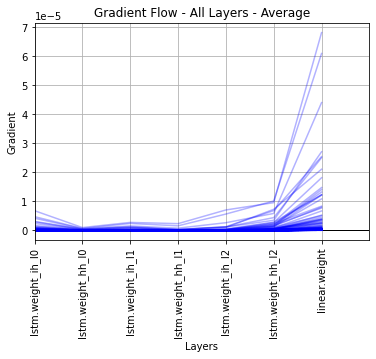

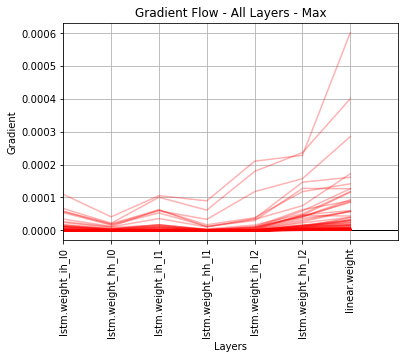

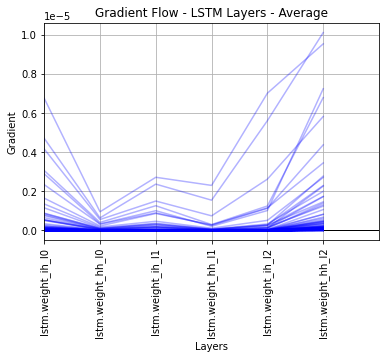

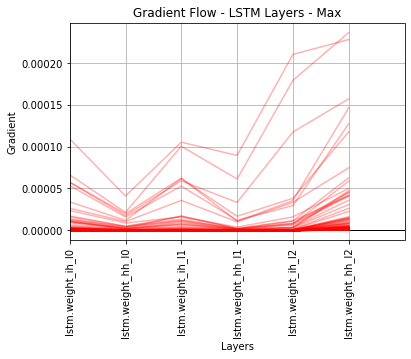

Number of gradients randomly sampled: 731
7
731
731
731
[2.84899532e-18 1.36319365e-21 6.08804931e-22 3.37489690e-22
 6.77626358e-21 1.13820052e-20 0.00000000e+00]
[5.25527644e-08 5.96099902e-09 1.87708727e-08 8.37173563e-09
 3.09774501e-08 1.22682111e-07 7.31841341e-07]
[1.09319401e-04 4.09636705e-05 1.05358966e-04 8.95382109e-05
 2.10263897e-04 2.36383712e-04 6.01557258e-04]


Training Time: 0:39:28.097430
N: 654 	MDA:49.54 	MAPE:-0.70 	MAE:2.16758e-03 	MSE:9.58927e-06
Num expected returns from training: 654
Initial Q:
 [7.09642135e-07 1.05713904e-05 2.55886785e-05 3.82827314e-05
 5.26130567e-05 6.39227051e-05 8.61578226e-05]
Unique bins: [0 1 2 3 4 5 6 7]
Counts / bin: [323  33  33  33  33  33  33 133]

Computing initial allocation policy from the training set...
77 -0.37 -0.0006
78 -0.37 0.0000
Executed buy at $87.58 on day  78 bin 2
79 -0.37 0.0005
80 -0.37 0.0002
81 -0.37 0.0003
82 -0.37 -0.0001
Executed sell at $88.10 on day 82 Profit: $0.5179
83 -0.37 -0.0002
84 -0.37 -0.0004
85 -0.37 0.0002
Executed buy at $87.64 on day  85 bin 7
86 -0.37 0.0007
87 -0.37 0.0006
88 -0.37 -0.0002
Executed sell at $87.69 on day 88 Profit: $0.0511
89 -0.37 0.0000
Executed buy at $87.97 on day  89 bin 4
90 -0.37 -0.0003
Executed sell at $88.17 on day 90 Profit: $0.2043
91 -0.37 0.0001
Executed buy at $88.34 on day  91 bin 7
92 -0.37 -0.0007
Executed sell at $88.57 on day 9

308 -0.34 -0.0000
Executed sell at $96.82 on day 308 Profit: $-0.3787
309 -0.34 0.0002
Executed buy at $97.28 on day  309 bin 7
310 -0.34 -0.0001
Executed sell at $97.61 on day 310 Profit: $0.3267
311 -0.34 0.0002
Executed buy at $96.82 on day  311 bin 7
312 -0.34 0.0001
313 -0.34 0.0001
314 -0.34 0.0001
315 -0.33 0.0000
316 -0.33 0.0001
317 -0.33 -0.0004
Executed sell at $98.46 on day 317 Profit: $1.6483
318 -0.33 -0.0000
319 -0.34 -0.0003
320 -0.34 -0.0001
321 -0.34 -0.0001
322 -0.34 -0.0000
323 -0.35 0.0001
Executed buy at $94.18 on day  323 bin 6
324 -0.35 0.0000
325 -0.35 0.0000
326 -0.35 0.0000
327 -0.35 0.0000
328 -0.35 0.0001
329 -0.35 0.0001
330 -0.34 -0.0001
Executed sell at $95.32 on day 330 Profit: $1.1360
331 -0.35 -0.0001
332 -0.35 0.0000
Executed buy at $94.67 on day  332 bin 1
333 -0.34 -0.0000
Executed sell at $95.58 on day 333 Profit: $0.9058
334 -0.34 -0.0001
335 -0.35 -0.0000
336 -0.35 -0.0003
337 -0.35 0.0002
Executed buy at $93.45 on day  337 bin 7
338 -0.35 -0.00

589 -0.27 0.0000
590 -0.27 -0.0000
Executed sell at $114.41 on day 590 Profit: $-0.4083
591 -0.28 0.0000
Executed buy at $113.16 on day  591 bin 3
592 -0.27 -0.0000
Executed sell at $114.86 on day 592 Profit: $1.6938
593 -0.27 -0.0000
594 -0.27 0.0000
Executed buy at $116.25 on day  594 bin 2
595 -0.27 -0.0001
Executed sell at $116.11 on day 595 Profit: $-0.1367
596 -0.27 0.0001
Executed buy at $116.40 on day  596 bin 5
597 -0.27 -0.0000
Executed sell at $114.78 on day 597 Profit: $-1.6176
598 -0.27 0.0000
Executed buy at $115.42 on day  598 bin 3
599 -0.27 -0.0001
Executed sell at $114.33 on day 599 Profit: $-1.0859
600 -0.28 0.0001
Executed buy at $113.79 on day  600 bin 6
601 -0.28 -0.0001
Executed sell at $112.62 on day 601 Profit: $-1.1696
602 -0.27 0.0000
Executed buy at $114.22 on day  602 bin 4
603 -0.27 0.0001
604 -0.27 0.0001
605 -0.27 0.0000
606 -0.27 0.0000
607 -0.27 0.0001
608 -0.27 -0.0000
Executed sell at $116.18 on day 608 Profit: $1.9593
609 -0.27 0.0000
Executed buy a

Executed buy at $95.94 on day  110 bin 4
Executed sell at $95.08 on day 111 Profit: $-0.8677
Executed buy at $95.79 on day  121 bin 3
Executed sell at $98.26 on day 124 Profit: $2.4715
Executed buy at $98.38 on day  137 bin 4
Executed sell at $100.45 on day 140 Profit: $2.0608
Executed buy at $98.38 on day  150 bin 6
Executed sell at $95.46 on day 151 Profit: $-2.9208
Executed buy at $97.24 on day  153 bin 6
Executed sell at $97.69 on day 154 Profit: $0.4493
Executed buy at $86.79 on day  165 bin 2
Executed sell at $90.38 on day 166 Profit: $3.5922
Executed buy at $90.44 on day  167 bin 4
Executed sell at $85.98 on day 169 Profit: $-4.4571
Executed buy at $77.95 on day  171 bin 3
Executed sell at $75.98 on day 172 Profit: $-1.9636
Executed buy at $72.94 on day  232 bin 6
Executed sell at $73.43 on day 233 Profit: $0.4870
Executed buy at $64.44 on day  287 bin 6
Executed sell at $65.75 on day 288 Profit: $1.3134
Executed buy at $64.13 on day  292 bin 6
Executed sell at $66.01 on day 293

In [343]:
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.0001, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)

Loading from file:  ../../../data/yahoo_data/SPY_01-01-2005.csv


C:\Users\q2\Anaconda3\envs\mlp\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 0.001
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	4.42e-05 	-0.003 	-0.003 	5.37e-07 	-0.377 	-0.375 	-0.374 	0.008 	0.011
  1 	2.56e-05 	0.001 	0.011 	4.28e-07 	-0.374 	-0.375 	-0.374 	-0.003 	-0.001
  2 	2.24e-05 	0.005 	-0.001 	3.30e-08 	-0.374 	-0.374 	-0.374 	0.001 	0.001
  3 	6.65e-06 	0.004 	0.001 	9.90e-06 	-0.374 	-0.373 	-0.376 	0.002 	-0.007
  4 	9.84e-06 	0.006 	-0.007 	6.77e-07 	-0.376 	-0.374 	-0.375 	0.006 	0.004
  5 	6.90e-06 	0.011 	0.004 	1.87e-05 	-0.375 	-0.377 	-0.372 	-0.005 	0.009
  6 	5.33e-06 	0.009 	0.009 	2.32e-06 	-0.372 	-0.374 	-0.373 	-0.005 	-0.001
  7 	5.17e-06 	0.005 	-0.001 	5.22e-06 	-0.373 	-0.374 	-0.371 	-0.003 	0.004
  8 	2.81e-06 	0.005 	0.004 	2.70e-07 	-0.371 	-0.371 	-0.371 	0.002 	0.001
  9 	2.35e-06 	-0.004 	0.001 	1.17e-05 	-0.371 	-0.370 	-0.374 	0.002 

103 	8.98e-08 	0.004 	0.003 	7.62e-06 	-0.373 	-0.373 	-0.371 	-0.000 	0.008
104 	1.08e-07 	0.009 	0.008 	8.30e-06 	-0.371 	-0.370 	-0.373 	0.000 	-0.008
105 	3.89e-08 	-0.009 	-0.008 	6.31e-07 	-0.373 	-0.373 	-0.372 	0.001 	0.004
106 	1.07e-08 	0.004 	0.004 	1.27e-05 	-0.372 	-0.372 	-0.368 	0.001 	0.011
107 	2.10e-07 	0.013 	0.011 	4.53e-06 	-0.368 	-0.369 	-0.367 	-0.001 	0.005
108 	2.02e-07 	0.007 	0.005 	2.73e-06 	-0.367 	-0.367 	-0.366 	-0.002 	0.003
109 	7.30e-08 	0.004 	0.003 	8.82e-07 	-0.366 	-0.366 	-0.365 	-0.001 	0.001
110 	1.72e-07 	0.002 	0.001 	2.11e-06 	-0.365 	-0.365 	-0.364 	-0.000 	0.004
111 	1.31e-07 	0.005 	0.004 	6.45e-08 	-0.364 	-0.364 	-0.364 	-0.001 	-0.001
112 	2.66e-07 	-0.002 	-0.001 	2.87e-06 	-0.364 	-0.364 	-0.365 	0.001 	-0.004
113 	7.51e-08 	-0.005 	-0.004 	2.19e-06 	-0.365 	-0.365 	-0.364 	0.001 	0.005
114 	8.88e-08 	0.005 	0.005 	2.98e-07 	-0.364 	-0.363 	-0.362 	0.002 	0.003
115 	2.45e-08 	0.004 	0.003 	2.82e-06 	-0.362 	-0.363 	-0.364 	-0.001 	-0

209 	1.71e-09 	0.010 	0.010 	2.48e-07 	-0.352 	-0.352 	-0.352 	-0.000 	0.001
210 	9.14e-08 	0.001 	0.001 	1.09e-06 	-0.352 	-0.351 	-0.352 	0.001 	-0.002
211 	1.49e-08 	-0.002 	-0.002 	6.70e-07 	-0.352 	-0.353 	-0.352 	-0.000 	0.002
212 	3.87e-08 	0.001 	0.002 	4.78e-06 	-0.352 	-0.352 	-0.354 	0.000 	-0.006
213 	1.97e-08 	-0.006 	-0.006 	1.12e-07 	-0.354 	-0.354 	-0.354 	0.000 	-0.001
214 	5.97e-09 	-0.001 	-0.001 	1.11e-06 	-0.354 	-0.354 	-0.353 	-0.000 	0.003
215 	1.08e-07 	0.004 	0.003 	1.86e-07 	-0.353 	-0.353 	-0.353 	-0.000 	0.001
216 	6.12e-08 	0.000 	0.001 	4.43e-06 	-0.353 	-0.353 	-0.350 	0.001 	0.007
217 	1.03e-07 	0.008 	0.007 	3.86e-06 	-0.350 	-0.351 	-0.349 	-0.002 	0.004
218 	8.02e-09 	0.004 	0.004 	7.30e-07 	-0.349 	-0.349 	-0.350 	-0.000 	-0.003
219 	2.51e-08 	-0.002 	-0.003 	9.27e-07 	-0.350 	-0.350 	-0.351 	-0.000 	-0.003
220 	1.72e-08 	-0.004 	-0.003 	3.62e-06 	-0.351 	-0.351 	-0.353 	0.000 	-0.005
221 	2.15e-07 	-0.006 	-0.005 	2.70e-08 	-0.353 	-0.353 	-0.353 	

315 	3.71e-08 	0.009 	0.009 	3.95e-08 	-0.333 	-0.333 	-0.333 	-0.001 	-0.001
316 	1.97e-08 	-0.002 	-0.001 	3.41e-07 	-0.333 	-0.333 	-0.333 	0.000 	0.002
317 	3.46e-10 	0.002 	0.002 	1.63e-07 	-0.333 	-0.332 	-0.333 	0.001 	-0.001
318 	1.30e-07 	-0.002 	-0.001 	2.29e-05 	-0.333 	-0.332 	-0.337 	0.001 	-0.012
319 	4.79e-07 	-0.014 	-0.012 	2.83e-05 	-0.337 	-0.337 	-0.342 	0.002 	-0.013
320 	4.70e-10 	-0.013 	-0.013 	5.33e-07 	-0.342 	-0.342 	-0.341 	-0.000 	0.002
321 	2.51e-07 	0.001 	0.002 	9.89e-07 	-0.341 	-0.341 	-0.342 	0.001 	-0.001
322 	7.37e-08 	-0.002 	-0.001 	5.10e-05 	-0.342 	-0.341 	-0.348 	0.001 	-0.019
323 	4.44e-08 	-0.020 	-0.019 	3.89e-06 	-0.348 	-0.348 	-0.350 	0.001 	-0.005
324 	3.17e-08 	-0.006 	-0.005 	5.33e-06 	-0.350 	-0.350 	-0.348 	0.000 	0.007
325 	3.34e-08 	0.006 	0.007 	7.91e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.008
326 	1.46e-09 	-0.008 	-0.008 	7.18e-06 	-0.350 	-0.350 	-0.353 	0.000 	-0.008
327 	4.11e-10 	-0.008 	-0.008 	6.87e-06 	-0.353 	-0.353 	-0.3

421 	6.95e-10 	0.002 	0.002 	2.23e-07 	-0.322 	-0.322 	-0.323 	-0.000 	-0.001
422 	7.68e-11 	-0.001 	-0.001 	6.27e-08 	-0.323 	-0.323 	-0.322 	-0.000 	0.001
423 	8.66e-09 	0.000 	0.001 	1.84e-07 	-0.322 	-0.322 	-0.322 	0.000 	0.001
424 	7.35e-10 	0.001 	0.001 	2.36e-07 	-0.322 	-0.322 	-0.322 	0.000 	-0.001
425 	6.92e-10 	-0.001 	-0.001 	1.05e-05 	-0.322 	-0.322 	-0.319 	0.000 	0.009
426 	5.34e-10 	0.009 	0.009 	9.65e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.003
427 	4.81e-09 	0.003 	0.003 	4.06e-07 	-0.318 	-0.318 	-0.318 	-0.000 	0.002
428 	1.22e-10 	0.002 	0.002 	1.51e-06 	-0.318 	-0.317 	-0.319 	0.000 	-0.003
429 	3.84e-09 	-0.003 	-0.003 	2.07e-07 	-0.319 	-0.319 	-0.318 	0.000 	0.001
430 	2.85e-09 	0.001 	0.001 	2.47e-07 	-0.318 	-0.318 	-0.318 	0.000 	0.002
431 	5.47e-11 	0.002 	0.002 	1.29e-08 	-0.318 	-0.318 	-0.318 	-0.000 	0.000
432 	2.31e-10 	0.000 	0.000 	3.27e-06 	-0.318 	-0.318 	-0.316 	-0.000 	0.005
433 	4.36e-09 	0.005 	0.005 	1.47e-06 	-0.316 	-0.316 	-0.315 	-0.000 	0.

527 	1.71e-10 	0.002 	0.001 	5.90e-05 	-0.304 	-0.304 	-0.311 	-0.000 	-0.019
528 	1.81e-11 	-0.019 	-0.019 	8.23e-06 	-0.311 	-0.311 	-0.309 	0.000 	0.007
529 	8.68e-11 	0.007 	0.007 	2.59e-07 	-0.309 	-0.309 	-0.308 	0.000 	0.001
530 	8.11e-10 	0.001 	0.001 	1.21e-06 	-0.308 	-0.308 	-0.309 	0.000 	-0.003
531 	1.53e-10 	-0.003 	-0.003 	2.21e-05 	-0.309 	-0.309 	-0.304 	0.000 	0.012
532 	3.14e-10 	0.012 	0.012 	4.66e-06 	-0.304 	-0.304 	-0.302 	0.000 	0.005
533 	9.82e-10 	0.006 	0.005 	4.28e-05 	-0.302 	-0.302 	-0.296 	-0.000 	0.016
534 	2.67e-10 	0.016 	0.016 	1.28e-07 	-0.296 	-0.296 	-0.296 	0.000 	-0.001
535 	6.53e-09 	-0.001 	-0.001 	4.61e-07 	-0.296 	-0.296 	-0.295 	-0.000 	0.001
536 	8.12e-11 	0.001 	0.001 	2.52e-07 	-0.295 	-0.295 	-0.296 	-0.000 	-0.001
537 	2.27e-08 	-0.002 	-0.001 	1.21e-06 	-0.296 	-0.296 	-0.297 	0.000 	-0.002
538 	4.16e-12 	-0.002 	-0.002 	8.65e-06 	-0.297 	-0.297 	-0.300 	0.000 	-0.007
539 	2.56e-09 	-0.007 	-0.007 	1.35e-07 	-0.300 	-0.300 	-0.299 	0.0

633 	6.01e-13 	-0.005 	-0.005 	2.16e-06 	-0.290 	-0.290 	-0.288 	-0.000 	0.004
634 	4.62e-13 	0.004 	0.004 	3.94e-05 	-0.288 	-0.288 	-0.295 	0.000 	-0.015
635 	2.75e-13 	-0.015 	-0.015 	3.11e-05 	-0.295 	-0.295 	-0.300 	0.000 	-0.014
636 	2.47e-13 	-0.014 	-0.014 	8.99e-06 	-0.300 	-0.300 	-0.297 	-0.000 	0.008
637 	2.94e-13 	0.008 	0.008 	5.45e-05 	-0.297 	-0.297 	-0.290 	0.000 	0.018
638 	2.38e-13 	0.018 	0.018 	3.93e-08 	-0.290 	-0.290 	-0.290 	0.000 	-0.000
639 	3.56e-13 	-0.000 	-0.000 	6.74e-07 	-0.290 	-0.290 	-0.289 	-0.000 	0.002
640 	7.15e-13 	0.002 	0.002 	2.37e-05 	-0.289 	-0.289 	-0.284 	-0.000 	0.012
641 	7.10e-13 	0.012 	0.012 	1.34e-07 	-0.284 	-0.284 	-0.285 	-0.000 	-0.001
642 	1.73e-13 	-0.001 	-0.001 	2.62e-05 	-0.285 	-0.285 	-0.280 	-0.000 	0.012
643 	7.14e-13 	0.012 	0.012 	1.52e-05 	-0.280 	-0.280 	-0.284 	-0.000 	-0.009
644 	2.14e-13 	-0.009 	-0.009 	8.35e-05 	-0.284 	-0.284 	-0.293 	0.000 	-0.022
645 	6.10e-13 	-0.022 	-0.022 	6.36e-05 	-0.293 	-0.293 	-0.285

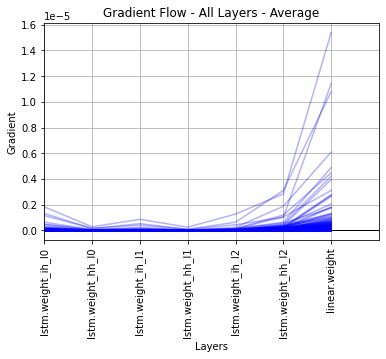

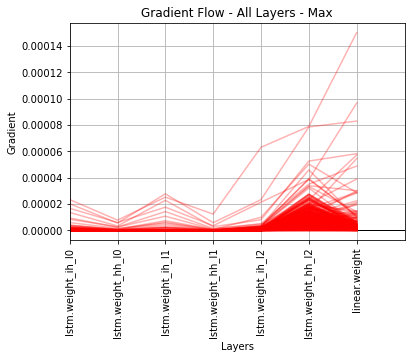

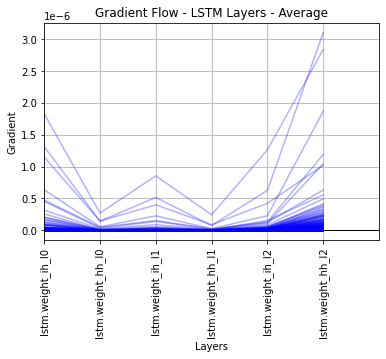

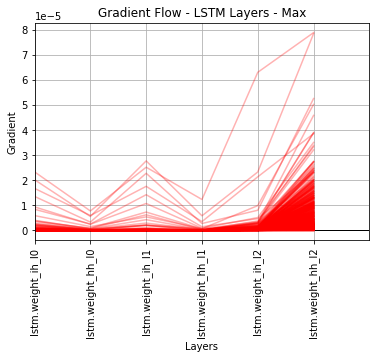

Number of gradients randomly sampled: 731
7
731
731
731
[3.50414387e-22 2.08653078e-24 2.06536659e-23 1.29246971e-25
 5.23191737e-23 2.12550682e-26 0.00000000e+00]
[1.24567628e-08 1.10355183e-09 3.95477099e-09 7.70748969e-10
 6.52847824e-09 3.57732464e-08 1.77961991e-07]
[2.33087558e-05 7.71366922e-06 2.76878709e-05 1.22915853e-05
 6.30379509e-05 7.88739417e-05 1.50136912e-04]


Training Time: 0:39:10.028649
N: 654 	MDA:47.40 	MAPE:-0.71 	MAE:2.18213e-03 	MSE:9.67065e-06
Num expected returns from training: 654
Initial Q:
 [0.00000000e+00 1.10858643e-06 1.16180667e-05 4.24494557e-05
 8.95418398e-05 1.65086922e-04 2.69185069e-04]
Unique bins: [0 1 2 3 4 5 6 7]
Counts / bin: [302  36  35  35  35  35  35 141]

Computing initial allocation policy from the training set...
77 -0.37 0.0004
Executed buy at $87.12 on day  77 bin 7
78 -0.37 -0.0001
Executed sell at $87.58 on day 78 Profit: $0.4669
79 -0.37 -0.0025
80 -0.37 -0.0018
81 -0.37 0.0007
Executed buy at $87.91 on day  81 bin 7
82 -0.37 0.0017
83 -0.37 0.0007
84 -0.37 -0.0020
Executed sell at $87.58 on day 84 Profit: $-0.3356
85 -0.37 0.0026
Executed buy at $87.64 on day  85 bin 7
86 -0.37 0.0006
87 -0.37 0.0009
88 -0.37 -0.0002
Executed sell at $87.69 on day 88 Profit: $0.0511
89 -0.37 0.0029
Executed buy at $87.97 on day  89 bin 7
90 -0.37 -0.0011
Executed sell at $88.17 on day 90 Profit: $0.2043
91 -0.37 -0.00

372 -0.35 0.0000
Executed buy at $94.49 on day  372 bin 4
373 -0.34 0.0001
374 -0.34 -0.0000
Executed sell at $95.34 on day 374 Profit: $0.8502
375 -0.35 0.0004
Executed buy at $94.87 on day  375 bin 7
376 -0.34 0.0006
377 -0.34 -0.0000
Executed sell at $95.77 on day 377 Profit: $0.8949
378 -0.34 -0.0007
379 -0.34 -0.0009
380 -0.35 0.0003
Executed buy at $95.01 on day  380 bin 6
381 -0.35 0.0005
382 -0.35 0.0002
383 -0.35 0.0005
384 -0.35 0.0000
385 -0.34 -0.0001
Executed sell at $95.92 on day 385 Profit: $0.9098
386 -0.34 -0.0001
387 -0.34 0.0001
Executed buy at $96.97 on day  387 bin 4
388 -0.34 -0.0003
Executed sell at $97.46 on day 388 Profit: $0.4922
389 -0.34 -0.0001
390 -0.34 0.0000
Executed buy at $97.04 on day  390 bin 3
391 -0.34 -0.0002
Executed sell at $96.77 on day 391 Profit: $-0.2685
392 -0.34 0.0001
Executed buy at $96.68 on day  392 bin 5
393 -0.34 0.0006
394 -0.34 -0.0003
Executed sell at $97.27 on day 394 Profit: $0.5817
395 -0.34 0.0000
Executed buy at $97.38 on day

730 -0.28 0.0000
Expected Gains per Bin: [ 0.         -1.73883072  3.63156702  1.38623842  3.92404845 -2.79685563
  3.5272671  -2.93436735]
Trades per bin: [ 0. 19. 19. 17. 13. 15. 14. 61.]

Initial Allocation Policy: [0 0 1 1 1 0 1 0]

PERFORMING VALIDATION...
Executed buy at $102.89 on day  1 bin 2
Executed sell at $102.74 on day 3 Profit: $-0.1534
Executed buy at $103.55 on day  6 bin 2
Executed sell at $104.61 on day 7 Profit: $1.0586
Executed buy at $103.69 on day  8 bin 2
Executed sell at $103.66 on day 9 Profit: $-0.0230
Executed buy at $103.40 on day  12 bin 2
Executed sell at $102.66 on day 21 Profit: $-0.7364
Executed buy at $100.53 on day  22 bin 2
Executed sell at $98.19 on day 24 Profit: $-2.3473
Executed buy at $101.72 on day  25 bin 2
Executed sell at $99.42 on day 28 Profit: $-2.2936
Executed buy at $68.47 on day  227 bin 3
Executed sell at $69.89 on day 229 Profit: $1.4218
Executed buy at $69.98 on day  236 bin 4
Executed sell at $68.43 on day 238 Profit: $-1.5554
Exec

Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 0.01
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	3.26e-05 	-0.006 	-0.003 	3.75e-10 	-0.377 	-0.374 	-0.374 	0.011 	0.011
  1 	1.43e-05 	0.004 	0.011 	1.29e-08 	-0.374 	-0.374 	-0.374 	-0.002 	-0.001
  2 	1.36e-05 	0.011 	-0.001 	2.51e-05 	-0.374 	-0.369 	-0.374 	0.017 	0.001
  3 	5.06e-06 	-0.003 	0.001 	5.40e-06 	-0.374 	-0.374 	-0.376 	-0.000 	-0.007
  4 	1.51e-05 	0.008 	-0.007 	1.04e-05 	-0.376 	-0.372 	-0.375 	0.014 	0.004
  5 	1.25e-05 	0.021 	0.004 	4.77e-07 	-0.375 	-0.373 	-0.372 	0.006 	0.009
  6 	2.31e-05 	-0.000 	0.009 	4.25e-06 	-0.372 	-0.375 	-0.373 	-0.007 	-0.001
  7 	6.58e-06 	-0.007 	-0.001 	1.33e-06 	-0.373 	-0.370 	-0.371 	0.007 	0.004
  8 	4.86e-06 	0.007 	0.004 	3.99e-06 	-0.371 	-0.373 	-0.371 	-0.005 	0.001
  9 	2.35e-05 	-0.010 	0.001 	3.81e-07 	-0.371 	-0.373 	-0.374 	-0.0

103 	1.62e-10 	0.003 	0.003 	6.83e-06 	-0.373 	-0.373 	-0.371 	0.000 	0.008
104 	3.70e-08 	0.008 	0.008 	7.56e-06 	-0.371 	-0.371 	-0.373 	-0.000 	-0.008
105 	1.08e-08 	-0.008 	-0.008 	1.66e-06 	-0.373 	-0.373 	-0.372 	-0.000 	0.004
106 	1.79e-08 	0.004 	0.004 	1.39e-05 	-0.372 	-0.372 	-0.368 	0.000 	0.011
107 	1.95e-08 	0.011 	0.011 	2.85e-06 	-0.368 	-0.368 	-0.367 	0.000 	0.005
108 	1.94e-08 	0.005 	0.005 	7.71e-07 	-0.367 	-0.367 	-0.366 	-0.000 	0.003
109 	5.56e-10 	0.003 	0.003 	1.94e-07 	-0.366 	-0.366 	-0.365 	0.000 	0.001
110 	6.72e-09 	0.002 	0.001 	2.03e-06 	-0.365 	-0.365 	-0.364 	-0.000 	0.004
111 	1.02e-08 	0.004 	0.004 	2.36e-08 	-0.364 	-0.364 	-0.364 	-0.000 	-0.001
112 	3.08e-09 	-0.001 	-0.001 	1.89e-06 	-0.364 	-0.364 	-0.365 	0.000 	-0.004
113 	1.66e-09 	-0.004 	-0.004 	3.32e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.005
114 	4.57e-09 	0.005 	0.005 	1.32e-06 	-0.364 	-0.364 	-0.362 	-0.000 	0.003
115 	1.09e-09 	0.004 	0.003 	3.76e-06 	-0.362 	-0.363 	-0.364 	-0.000 	-0

209 	3.63e-09 	0.010 	0.010 	2.00e-07 	-0.352 	-0.352 	-0.352 	-0.000 	0.001
210 	1.05e-09 	0.001 	0.001 	5.36e-07 	-0.352 	-0.352 	-0.352 	-0.000 	-0.002
211 	3.39e-08 	-0.003 	-0.002 	2.27e-07 	-0.352 	-0.352 	-0.352 	0.001 	0.002
212 	6.62e-09 	0.002 	0.002 	4.18e-06 	-0.352 	-0.352 	-0.354 	0.000 	-0.006
213 	1.40e-09 	-0.006 	-0.006 	4.97e-08 	-0.354 	-0.354 	-0.354 	0.000 	-0.001
214 	6.26e-09 	-0.001 	-0.001 	8.19e-07 	-0.354 	-0.354 	-0.353 	-0.000 	0.003
215 	8.78e-09 	0.003 	0.003 	1.15e-07 	-0.353 	-0.353 	-0.353 	-0.000 	0.001
216 	3.09e-10 	0.001 	0.001 	5.45e-06 	-0.353 	-0.353 	-0.350 	0.000 	0.007
217 	2.77e-09 	0.007 	0.007 	1.86e-06 	-0.350 	-0.350 	-0.349 	0.000 	0.004
218 	8.25e-10 	0.004 	0.004 	1.03e-06 	-0.349 	-0.349 	-0.350 	0.000 	-0.003
219 	5.79e-09 	-0.003 	-0.003 	1.25e-06 	-0.350 	-0.350 	-0.351 	-0.000 	-0.003
220 	3.61e-10 	-0.003 	-0.003 	3.23e-06 	-0.351 	-0.351 	-0.353 	0.000 	-0.005
221 	1.67e-08 	-0.005 	-0.005 	1.08e-07 	-0.353 	-0.353 	-0.353 	0.

315 	5.23e-09 	0.009 	0.009 	1.86e-07 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
316 	4.31e-10 	-0.001 	-0.001 	5.18e-07 	-0.333 	-0.333 	-0.333 	-0.000 	0.002
317 	5.53e-10 	0.002 	0.002 	3.37e-08 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
318 	6.92e-10 	-0.001 	-0.001 	1.95e-05 	-0.333 	-0.333 	-0.337 	-0.000 	-0.012
319 	1.77e-08 	-0.012 	-0.012 	2.23e-05 	-0.337 	-0.337 	-0.342 	-0.000 	-0.013
320 	5.00e-09 	-0.013 	-0.013 	5.12e-07 	-0.342 	-0.342 	-0.341 	0.000 	0.002
321 	6.01e-09 	0.002 	0.002 	2.77e-07 	-0.341 	-0.341 	-0.342 	0.000 	-0.001
322 	7.29e-09 	-0.001 	-0.001 	4.63e-05 	-0.342 	-0.342 	-0.348 	-0.000 	-0.019
323 	4.68e-09 	-0.019 	-0.019 	3.13e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.005
324 	1.47e-09 	-0.005 	-0.005 	6.06e-06 	-0.350 	-0.350 	-0.348 	-0.000 	0.007
325 	1.82e-10 	0.007 	0.007 	7.17e-06 	-0.348 	-0.348 	-0.350 	-0.000 	-0.008
326 	5.56e-10 	-0.008 	-0.008 	7.04e-06 	-0.350 	-0.350 	-0.353 	-0.000 	-0.008
327 	2.24e-10 	-0.008 	-0.008 	7.64e-06 	-0.353 	-0.35

421 	4.79e-08 	0.002 	0.002 	2.26e-07 	-0.322 	-0.322 	-0.323 	0.000 	-0.001
422 	3.20e-10 	-0.001 	-0.001 	5.28e-08 	-0.323 	-0.323 	-0.322 	-0.000 	0.001
423 	5.61e-09 	0.001 	0.001 	2.79e-07 	-0.322 	-0.322 	-0.322 	-0.000 	0.001
424 	1.68e-08 	0.001 	0.001 	3.43e-07 	-0.322 	-0.322 	-0.322 	0.000 	-0.001
425 	5.21e-09 	-0.001 	-0.001 	1.14e-05 	-0.322 	-0.322 	-0.319 	-0.000 	0.009
426 	1.04e-08 	0.009 	0.009 	9.54e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.003
427 	1.11e-09 	0.002 	0.003 	3.66e-07 	-0.318 	-0.318 	-0.318 	-0.000 	0.002
428 	8.40e-10 	0.002 	0.002 	1.47e-06 	-0.318 	-0.318 	-0.319 	0.000 	-0.003
429 	5.32e-09 	-0.003 	-0.003 	2.55e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.001
430 	3.41e-08 	-0.001 	0.001 	3.10e-08 	-0.318 	-0.317 	-0.318 	0.002 	0.002
431 	5.60e-09 	0.002 	0.002 	1.34e-07 	-0.318 	-0.318 	-0.318 	-0.001 	0.000
432 	1.56e-08 	-0.000 	0.000 	2.16e-06 	-0.318 	-0.317 	-0.316 	0.001 	0.005
433 	4.66e-08 	0.005 	0.005 	1.32e-06 	-0.316 	-0.316 	-0.315 	-0.000 

527 	4.87e-10 	0.001 	0.001 	5.91e-05 	-0.304 	-0.304 	-0.311 	0.000 	-0.019
528 	5.79e-11 	-0.019 	-0.019 	8.35e-06 	-0.311 	-0.311 	-0.309 	0.000 	0.007
529 	4.19e-09 	0.007 	0.007 	2.69e-07 	-0.309 	-0.309 	-0.308 	0.000 	0.001
530 	5.37e-10 	0.001 	0.001 	1.20e-06 	-0.308 	-0.308 	-0.309 	0.000 	-0.003
531 	1.15e-09 	-0.003 	-0.003 	2.21e-05 	-0.309 	-0.309 	-0.304 	-0.000 	0.012
532 	1.29e-10 	0.012 	0.012 	4.70e-06 	-0.304 	-0.304 	-0.302 	0.000 	0.005
533 	8.46e-10 	0.006 	0.005 	4.27e-05 	-0.302 	-0.302 	-0.296 	-0.000 	0.016
534 	3.23e-09 	0.016 	0.016 	9.64e-08 	-0.296 	-0.296 	-0.296 	0.000 	-0.001
535 	4.52e-09 	-0.001 	-0.001 	3.49e-07 	-0.296 	-0.296 	-0.295 	0.000 	0.001
536 	2.56e-10 	0.001 	0.001 	2.91e-07 	-0.295 	-0.295 	-0.296 	0.000 	-0.001
537 	8.96e-11 	-0.001 	-0.001 	9.72e-07 	-0.296 	-0.296 	-0.297 	0.000 	-0.002
538 	7.76e-11 	-0.002 	-0.002 	8.88e-06 	-0.297 	-0.297 	-0.300 	0.000 	-0.007
539 	1.35e-10 	-0.007 	-0.007 	2.09e-07 	-0.300 	-0.300 	-0.299 	-0.00

633 	2.74e-12 	-0.005 	-0.005 	2.16e-06 	-0.290 	-0.290 	-0.288 	-0.000 	0.004
634 	5.81e-12 	0.004 	0.004 	3.94e-05 	-0.288 	-0.288 	-0.295 	0.000 	-0.015
635 	4.46e-11 	-0.015 	-0.015 	3.11e-05 	-0.295 	-0.295 	-0.300 	0.000 	-0.014
636 	1.05e-11 	-0.014 	-0.014 	8.98e-06 	-0.300 	-0.300 	-0.297 	0.000 	0.008
637 	1.18e-11 	0.008 	0.008 	5.45e-05 	-0.297 	-0.297 	-0.290 	0.000 	0.018
638 	1.22e-11 	0.018 	0.018 	3.82e-08 	-0.290 	-0.290 	-0.290 	-0.000 	-0.000
639 	8.14e-12 	-0.000 	-0.000 	6.79e-07 	-0.290 	-0.290 	-0.289 	-0.000 	0.002
640 	4.07e-13 	0.002 	0.002 	2.37e-05 	-0.289 	-0.289 	-0.284 	0.000 	0.012
641 	2.59e-11 	0.012 	0.012 	1.36e-07 	-0.284 	-0.284 	-0.285 	0.000 	-0.001
642 	2.27e-13 	-0.001 	-0.001 	2.62e-05 	-0.285 	-0.285 	-0.280 	0.000 	0.012
643 	2.84e-12 	0.012 	0.012 	1.52e-05 	-0.280 	-0.280 	-0.284 	0.000 	-0.009
644 	2.00e-12 	-0.009 	-0.009 	8.35e-05 	-0.284 	-0.284 	-0.293 	0.000 	-0.022
645 	1.01e-10 	-0.022 	-0.022 	6.37e-05 	-0.293 	-0.293 	-0.285 	-0

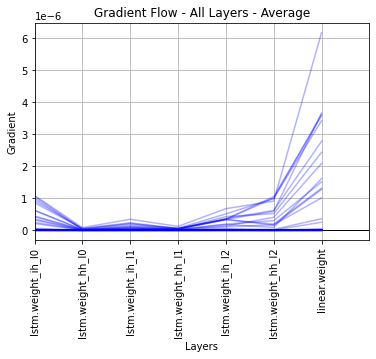

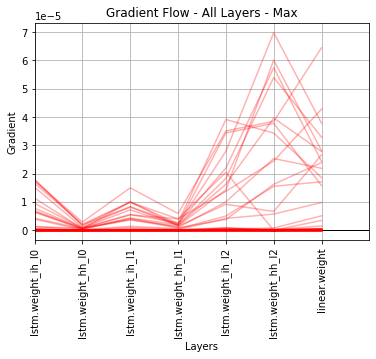

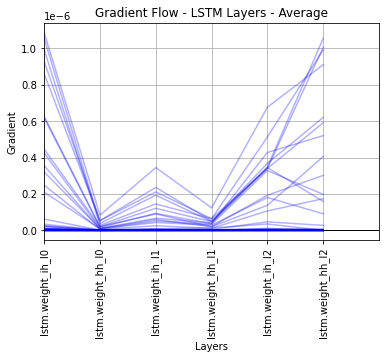

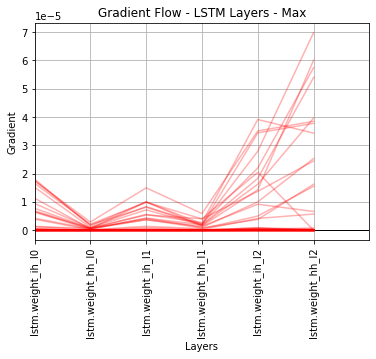

Number of gradients randomly sampled: 731
7
731
731
731
[1.33718144e-27 1.63547864e-30 0.00000000e+00 0.00000000e+00
 9.57283033e-41 5.48468219e-42 0.00000000e+00]
[1.14845252e-08 4.88662537e-10 2.34386156e-09 8.34275279e-10
 6.06044008e-09 9.66772608e-09 4.82908443e-08]
[1.81034375e-05 2.92461164e-06 1.49944326e-05 5.90840091e-06
 3.91442773e-05 6.98362928e-05 6.44668035e-05]


Training Time: 0:39:21.381698
N: 654 	MDA:48.93 	MAPE:-0.70 	MAE:2.17284e-03 	MSE:9.61278e-06
Num expected returns from training: 654
Initial Q:
 [0.00000000e+00 1.12563622e-06 2.28782797e-06 3.70848977e-06
 6.16572263e-06 9.10125956e-06 1.63137784e-05]
Unique bins: [0 1 2 3 4 5 6 7]
Counts / bin: [315  34  34  34  34  33  34 136]

Computing initial allocation policy from the training set...
77 -0.37 0.0003
Executed buy at $87.12 on day  77 bin 7
78 -0.37 0.0000
79 -0.37 -0.0001
Executed sell at $87.73 on day 79 Profit: $0.6128
80 -0.37 -0.0002
81 -0.37 -0.0002
82 -0.37 0.0000
Executed buy at $88.10 on day  82 bin 7
83 -0.37 0.0003
84 -0.37 0.0006
85 -0.37 -0.0005
Executed sell at $87.64 on day 85 Profit: $-0.4596
86 -0.37 0.0006
Executed buy at $87.48 on day  86 bin 7
87 -0.37 0.0001
88 -0.37 -0.0001
Executed sell at $87.69 on day 88 Profit: $0.2116
89 -0.37 0.0001
Executed buy at $87.97 on day  89 bin 7
90 -0.37 0.0017
91 -0.37 0.0014
92 -0.37 0.0001
93 -0.37 0.0000
94 -0.37 0.0001
9

324 -0.35 -0.0000
Executed sell at $93.71 on day 324 Profit: $-0.4752
325 -0.35 -0.0000
326 -0.35 -0.0000
327 -0.35 0.0000
Executed buy at $92.93 on day  327 bin 5
328 -0.35 0.0000
329 -0.35 0.0000
330 -0.34 0.0000
331 -0.35 0.0009
332 -0.35 0.0000
333 -0.34 0.0000
334 -0.34 -0.0000
Executed sell at $95.78 on day 334 Profit: $2.8436
335 -0.35 -0.0000
336 -0.35 -0.0000
337 -0.35 -0.0000
338 -0.35 -0.0001
339 -0.35 0.0000
Executed buy at $93.07 on day  339 bin 7
340 -0.36 -0.0002
Executed sell at $92.06 on day 340 Profit: $-1.0097
341 -0.36 0.0000
Executed buy at $90.99 on day  341 bin 7
342 -0.36 -0.0000
Executed sell at $91.69 on day 342 Profit: $0.7053
343 -0.35 0.0001
Executed buy at $93.64 on day  343 bin 7
344 -0.35 0.0000
345 -0.36 -0.0000
Executed sell at $92.23 on day 345 Profit: $-1.4132
346 -0.35 -0.0001
347 -0.35 0.0000
Executed buy at $93.22 on day  347 bin 7
348 -0.35 0.0000
349 -0.35 -0.0017
Executed sell at $92.80 on day 349 Profit: $-0.4251
350 -0.35 0.0000
Executed buy 

Executed buy at $112.50 on day  651 bin 1
652 -0.29 -0.0000
Executed sell at $110.93 on day 652 Profit: $-1.5644
653 -0.29 -0.0000
654 -0.28 -0.0000
655 -0.28 -0.0000
656 -0.28 -0.0000
657 -0.28 0.0000
Executed buy at $113.08 on day  657 bin 6
658 -0.28 0.0000
659 -0.27 -0.0000
Executed sell at $115.78 on day 659 Profit: $2.7036
660 -0.27 0.0000
Executed buy at $116.47 on day  660 bin 1
661 -0.27 -0.0000
Executed sell at $115.65 on day 661 Profit: $-0.8202
662 -0.27 0.0000
Executed buy at $115.96 on day  662 bin 5
663 -0.27 0.0000
664 -0.27 -0.0000
Executed sell at $115.52 on day 664 Profit: $-0.4426
665 -0.27 0.0000
Executed buy at $116.13 on day  665 bin 1
666 -0.26 -0.0000
Executed sell at $116.81 on day 666 Profit: $0.6867
667 -0.27 -0.0000
668 -0.26 0.0000
Executed buy at $117.74 on day  668 bin 4
669 -0.26 -0.0000
Executed sell at $117.58 on day 669 Profit: $-0.1602
670 -0.26 0.0000
Executed buy at $117.34 on day  670 bin 5
671 -0.26 0.0000
672 -0.26 0.0000
673 -0.26 0.0000
674 -

Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 0.1
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	2.66e-02 	-0.399 	-0.003 	4.30e-04 	-0.377 	-0.353 	-0.374 	0.075 	0.011
  1 	1.12e-03 	-0.102 	0.011 	9.93e-03 	-0.374 	-0.474 	-0.374 	-0.308 	-0.001
  2 	1.82e-02 	0.436 	-0.001 	1.30e-03 	-0.374 	-0.410 	-0.374 	-0.110 	0.001
  3 	1.40e-02 	-0.426 	0.001 	6.26e-03 	-0.374 	-0.297 	-0.376 	0.236 	-0.007
  4 	4.30e-03 	0.195 	-0.007 	8.32e-04 	-0.376 	-0.404 	-0.375 	-0.086 	0.004
  5 	1.36e-02 	-0.369 	0.004 	9.34e-02 	-0.375 	-0.067 	-0.372 	0.951 	0.009
  6 	1.41e-01 	1.043 	0.009 	5.17e-03 	-0.372 	-0.301 	-0.373 	0.219 	-0.001
  7 	4.07e-03 	0.180 	-0.001 	1.05e-05 	-0.373 	-0.368 	-0.371 	0.014 	0.004
  8 	3.46e-02 	0.557 	0.004 	5.17e-02 	-0.371 	-0.599 	-0.371 	-0.693 	0.001
  9 	7.00e-04 	-0.060 	0.001 	1.54e-04 	-0.371 	-0.361 	-0.374 	0.030

103 	8.39e-03 	0.003 	0.003 	6.77e-06 	-0.373 	-0.373 	-0.371 	0.000 	0.008
104 	1.08e-02 	0.008 	0.008 	7.59e-06 	-0.371 	-0.371 	-0.373 	0.000 	-0.008
105 	1.43e-02 	1.586 	-0.008 	4.88e-01 	-0.373 	-1.070 	-0.372 	-2.138 	0.004
106 	2.39e-02 	0.002 	0.004 	8.89e-06 	-0.372 	-0.371 	-0.368 	0.002 	0.011
107 	7.36e-02 	-2.883 	0.011 	8.12e-01 	-0.368 	0.535 	-0.367 	2.728 	0.005
108 	3.29e-02 	0.006 	0.005 	9.75e-07 	-0.367 	-0.367 	-0.366 	-0.000 	0.003
109 	3.62e-02 	-0.007 	0.003 	3.29e-06 	-0.366 	-0.363 	-0.365 	0.007 	0.001
110 	2.35e-02 	0.048 	0.001 	4.93e-04 	-0.365 	-0.386 	-0.364 	-0.063 	0.004
111 	1.10e-01 	-0.002 	0.004 	4.36e-07 	-0.364 	-0.365 	-0.364 	-0.003 	-0.001
112 	2.85e-02 	-0.001 	-0.001 	1.79e-06 	-0.364 	-0.364 	-0.365 	0.000 	-0.004
113 	1.05e-02 	-0.019 	-0.004 	7.88e-08 	-0.365 	-0.363 	-0.364 	0.006 	0.005
114 	1.88e-02 	0.081 	0.005 	4.22e-04 	-0.364 	-0.383 	-0.362 	-0.058 	0.003
115 	1.60e-01 	0.003 	0.003 	3.87e-06 	-0.362 	-0.362 	-0.364 	0.000 	-0.

209 	8.89e-03 	-0.004 	0.010 	1.29e-05 	-0.352 	-0.348 	-0.352 	0.012 	0.001
210 	8.40e-02 	-0.007 	0.001 	2.00e-05 	-0.352 	-0.348 	-0.352 	0.011 	-0.002
211 	3.04e-02 	-0.003 	-0.002 	2.10e-07 	-0.352 	-0.352 	-0.352 	0.001 	0.002
212 	6.87e-02 	-0.001 	0.002 	1.23e-05 	-0.352 	-0.350 	-0.354 	0.004 	-0.006
213 	6.37e-02 	-0.005 	-0.006 	8.63e-09 	-0.354 	-0.354 	-0.354 	-0.000 	-0.001
214 	8.29e-02 	0.260 	-0.001 	1.80e-03 	-0.354 	-0.396 	-0.353 	-0.120 	0.003
215 	2.13e-02 	0.003 	0.003 	1.00e-07 	-0.353 	-0.353 	-0.353 	0.000 	0.001
216 	2.66e-02 	0.000 	0.001 	4.54e-06 	-0.353 	-0.353 	-0.350 	0.001 	0.007
217 	3.95e-02 	0.007 	0.007 	2.01e-06 	-0.350 	-0.351 	-0.349 	-0.000 	0.004
218 	1.65e-03 	-0.014 	0.004 	9.71e-05 	-0.349 	-0.340 	-0.350 	0.025 	-0.003
219 	1.56e-02 	-0.003 	-0.003 	1.40e-06 	-0.350 	-0.350 	-0.351 	0.000 	-0.003
220 	7.47e-03 	0.133 	-0.003 	1.59e-03 	-0.351 	-0.393 	-0.353 	-0.120 	-0.005
221 	1.26e-01 	3.111 	-0.005 	1.63e+00 	-0.353 	-1.630 	-0.353 	-3

315 	3.19e-03 	0.009 	0.009 	1.94e-07 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
316 	5.00e-08 	-0.001 	-0.001 	5.17e-07 	-0.333 	-0.333 	-0.333 	0.000 	0.002
317 	5.02e-04 	0.002 	0.002 	3.88e-08 	-0.333 	-0.333 	-0.333 	0.000 	-0.001
318 	3.63e-02 	-0.001 	-0.001 	1.96e-05 	-0.333 	-0.333 	-0.337 	-0.000 	-0.012
319 	2.56e-06 	-0.012 	-0.012 	2.24e-05 	-0.337 	-0.337 	-0.342 	0.000 	-0.013
320 	3.81e-02 	-0.005 	-0.013 	8.29e-05 	-0.342 	-0.332 	-0.341 	0.027 	0.002
321 	3.13e-02 	0.625 	0.002 	5.49e-02 	-0.341 	-0.576 	-0.342 	-0.656 	-0.001
322 	1.93e-02 	1.017 	-0.001 	1.95e-03 	-0.342 	-0.304 	-0.348 	0.105 	-0.019
323 	1.20e-02 	-0.019 	-0.019 	2.68e-06 	-0.348 	-0.349 	-0.350 	-0.000 	-0.005
324 	5.13e-02 	0.105 	-0.005 	1.98e-03 	-0.350 	-0.392 	-0.348 	-0.120 	0.007
325 	1.99e-02 	0.954 	0.007 	1.78e-02 	-0.348 	-0.484 	-0.350 	-0.387 	-0.008
326 	4.47e-02 	-0.008 	-0.008 	6.89e-06 	-0.350 	-0.351 	-0.353 	-0.000 	-0.008
327 	2.92e-02 	-0.008 	-0.008 	6.92e-06 	-0.353 	-0.353 	-

421 	1.03e-04 	0.002 	0.002 	2.24e-07 	-0.322 	-0.322 	-0.323 	-0.000 	-0.001
422 	2.55e-02 	0.095 	-0.001 	2.36e-03 	-0.323 	-0.371 	-0.322 	-0.128 	0.001
423 	2.12e-02 	-0.001 	0.001 	2.88e-08 	-0.322 	-0.322 	-0.322 	0.002 	0.001
424 	1.37e-03 	-0.015 	0.001 	6.94e-05 	-0.322 	-0.314 	-0.322 	0.021 	-0.001
425 	1.30e-02 	-0.001 	-0.001 	9.80e-06 	-0.322 	-0.322 	-0.319 	0.000 	0.009
426 	2.56e-03 	-0.029 	0.009 	7.69e-05 	-0.319 	-0.309 	-0.318 	0.026 	0.003
427 	6.65e-02 	0.005 	0.003 	3.53e-06 	-0.318 	-0.319 	-0.318 	-0.003 	0.002
428 	8.03e-02 	0.001 	0.002 	1.58e-06 	-0.318 	-0.317 	-0.319 	0.000 	-0.003
429 	3.85e-02 	-0.003 	-0.003 	2.43e-07 	-0.319 	-0.319 	-0.318 	0.000 	0.001
430 	8.70e-02 	-0.005 	0.001 	6.10e-04 	-0.318 	-0.342 	-0.318 	-0.063 	0.002
431 	8.70e-02 	-0.387 	0.002 	5.69e-03 	-0.318 	-0.242 	-0.318 	0.198 	0.000
432 	3.39e-03 	0.000 	0.000 	3.10e-06 	-0.318 	-0.318 	-0.316 	-0.000 	0.005
433 	4.63e-02 	0.006 	0.005 	2.18e-06 	-0.316 	-0.313 	-0.315 	0.007 	

527 	4.14e-02 	0.001 	0.001 	5.94e-05 	-0.304 	-0.304 	-0.311 	0.000 	-0.019
528 	1.01e-01 	-0.020 	-0.019 	7.27e-06 	-0.311 	-0.311 	-0.309 	0.000 	0.007
529 	4.10e-02 	0.007 	0.007 	3.37e-10 	-0.309 	-0.308 	-0.308 	0.001 	0.001
530 	8.62e-02 	0.002 	0.001 	9.90e-07 	-0.308 	-0.308 	-0.309 	-0.000 	-0.003
531 	8.34e-02 	3.039 	-0.003 	1.69e+00 	-0.309 	-1.606 	-0.304 	-3.323 	0.012
532 	2.09e-02 	0.012 	0.012 	4.76e-06 	-0.304 	-0.304 	-0.302 	-0.000 	0.005
533 	1.70e-03 	0.012 	0.005 	9.84e-05 	-0.302 	-0.306 	-0.296 	-0.009 	0.016
534 	1.22e-02 	0.013 	0.016 	3.91e-06 	-0.296 	-0.294 	-0.296 	0.004 	-0.001
535 	1.05e-02 	-0.001 	-0.001 	2.76e-07 	-0.296 	-0.296 	-0.295 	0.000 	0.001
536 	6.05e-02 	0.002 	0.001 	4.15e-08 	-0.295 	-0.296 	-0.296 	-0.001 	-0.001
537 	2.71e-02 	-0.003 	-0.001 	2.34e-03 	-0.296 	-0.248 	-0.297 	0.118 	-0.002
538 	3.97e-10 	-0.002 	-0.002 	8.54e-06 	-0.297 	-0.297 	-0.300 	-0.000 	-0.007
539 	1.85e-03 	-0.007 	-0.007 	1.79e-07 	-0.300 	-0.300 	-0.299 	-0

633 	9.20e-02 	-0.040 	-0.005 	8.59e-06 	-0.290 	-0.291 	-0.288 	-0.004 	0.004
634 	1.47e-02 	1.267 	0.004 	2.98e-01 	-0.288 	-0.840 	-0.295 	-1.344 	-0.015
635 	2.24e-04 	-0.015 	-0.015 	3.11e-05 	-0.295 	-0.295 	-0.300 	0.000 	-0.014
636 	1.54e-01 	-0.014 	-0.014 	8.99e-06 	-0.300 	-0.300 	-0.297 	-0.000 	0.008
637 	3.60e-02 	0.008 	0.008 	5.45e-05 	-0.297 	-0.297 	-0.290 	0.000 	0.018
638 	1.01e-01 	0.047 	0.018 	2.19e-04 	-0.290 	-0.305 	-0.290 	-0.037 	-0.000
639 	1.04e-01 	0.000 	-0.000 	8.49e-07 	-0.290 	-0.290 	-0.289 	-0.000 	0.002
640 	3.88e-02 	0.002 	0.002 	2.36e-05 	-0.289 	-0.289 	-0.284 	0.000 	0.012
641 	1.40e-01 	1.305 	0.012 	4.64e-01 	-0.284 	-0.966 	-0.285 	-1.642 	-0.001
642 	7.14e-02 	-0.001 	-0.001 	2.66e-05 	-0.285 	-0.285 	-0.280 	-0.000 	0.012
643 	2.30e-02 	0.012 	0.012 	1.61e-05 	-0.280 	-0.280 	-0.284 	0.000 	-0.009
644 	4.73e-02 	-0.007 	-0.009 	6.45e-05 	-0.284 	-0.285 	-0.293 	-0.003 	-0.022
645 	2.87e-02 	-0.056 	-0.022 	2.61e-04 	-0.293 	-0.269 	-0.285

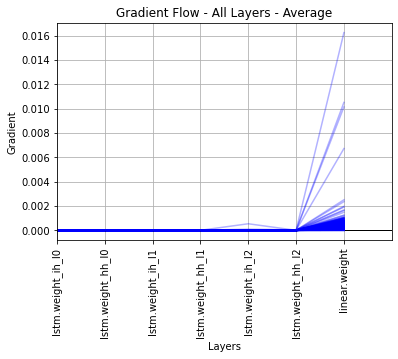

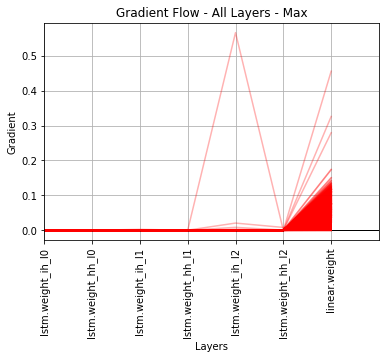

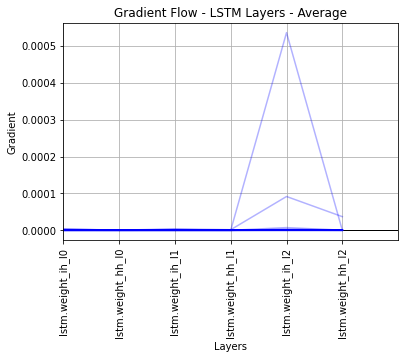

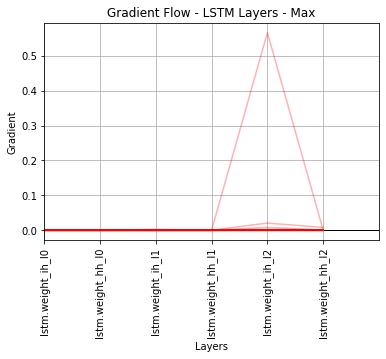

Number of gradients randomly sampled: 731
7
731
731
731
[0. 0. 0. 0. 0. 0. 0.]
[1.07136027e-08 3.05909240e-10 9.25118477e-09 2.28105529e-09
 8.85504680e-07 5.52900339e-08 3.95531257e-04]
[1.83900556e-04 6.00613566e-05 2.64917873e-03 3.42730113e-04
 5.66453934e-01 8.18481017e-03 4.55775410e-01]


Training Time: 0:39:26.317824
N: 654 	MDA:50.92 	MAPE:-20.97 	MAE:6.66326e-02 	MSE:5.29338e-02
Num expected returns from training: 654
Initial Q:
 [0.00000000e+00 7.39421546e-06 3.47278979e-05 9.31986469e-05
 2.52270179e-04 6.49209515e-04 3.21299988e-03]
Unique bins: [0 1 2 3 4 5 6 7]
Counts / bin: [315  34  34  34  34  33  34 136]

Computing initial allocation policy from the training set...
77 -0.37 1.2275
Executed buy at $87.12 on day  77 bin 7
78 -0.37 -0.0001
Executed sell at $87.58 on day 78 Profit: $0.4669
79 -0.37 0.1560
Executed buy at $87.73 on day  79 bin 7
80 -0.37 -0.0023
Executed sell at $87.17 on day 80 Profit: $-0.5618
81 -0.37 -0.0001
82 -0.37 -0.0494
83 -0.37 0.9765
Executed buy at $87.66 on day  83 bin 7
84 -0.37 -0.0009
Executed sell at $87.58 on day 84 Profit: $-0.0803
85 -0.37 0.3846
Executed buy at $87.64 on day  85 bin 7
86 -0.37 -0.0001
Executed sell at $87.48 on day 86 Profit: $-0.1605
87 -0.37 -0.0004
88 -0.37 -0.0399
89 -0.37 -1.9500
90 -0.37 -0.0001
91 -0.3

338 -0.35 -0.0057
Executed sell at $93.36 on day 338 Profit: $-0.7870
339 -0.35 -0.0025
340 -0.36 -1.5663
341 -0.36 -0.0004
342 -0.36 -0.0006
343 -0.35 -0.0021
344 -0.35 0.0104
Executed buy at $92.96 on day  344 bin 7
345 -0.36 0.0030
346 -0.35 0.0003
347 -0.35 0.0005
348 -0.35 -0.0003
Executed sell at $92.81 on day 348 Profit: $-0.1417
349 -0.35 0.0000
Executed buy at $92.80 on day  349 bin 2
350 -0.35 2.4317
351 -0.36 0.0000
352 -0.35 2.1981
353 -0.35 -0.0000
Executed sell at $94.91 on day 353 Profit: $2.1104
354 -0.35 0.0000
Executed buy at $94.92 on day  354 bin 2
355 -0.34 -0.0000
Executed sell at $95.31 on day 355 Profit: $0.3878
356 -0.35 0.0840
Executed buy at $94.76 on day  356 bin 7
357 -0.35 0.0000
358 -0.35 0.0000
359 -0.35 -0.0000
Executed sell at $94.60 on day 359 Profit: $-0.1640
360 -0.35 0.0000
Executed buy at $95.01 on day  360 bin 1
361 -0.35 -0.0000
Executed sell at $94.00 on day 361 Profit: $-1.0142
362 -0.35 0.0000
Executed buy at $92.47 on day  362 bin 2
363 -0.3

674 -0.25 -0.0000
Executed sell at $119.40 on day 674 Profit: $1.1140
675 -0.26 -0.0081
676 -0.26 0.2641
Executed buy at $118.63 on day  676 bin 7
677 -0.25 0.0000
678 -0.26 0.0002
679 -0.26 -0.4825
Executed sell at $117.34 on day 679 Profit: $-1.2895
680 -0.26 0.2179
Executed buy at $117.70 on day  680 bin 7
681 -0.26 -0.0000
Executed sell at $117.27 on day 681 Profit: $-0.4273
682 -0.27 -0.0034
683 -0.27 0.1224
Executed buy at $114.87 on day  683 bin 7
684 -0.27 0.0000
685 -0.27 0.0046
686 -0.27 0.1137
687 -0.26 0.0000
688 -0.26 0.0049
689 -0.26 0.2657
690 -0.26 0.0001
691 -0.27 -0.0026
Executed sell at $115.24 on day 691 Profit: $0.3739
692 -0.27 -0.0001
693 -0.27 -0.0009
694 -0.27 -0.0073
695 -0.28 0.0487
Executed buy at $112.86 on day  695 bin 7
696 -0.28 -0.0070
Executed sell at $112.29 on day 696 Profit: $-0.5723
697 -0.29 -0.0322
698 -0.29 -0.0000
699 -0.28 0.0000
Executed buy at $112.99 on day  699 bin 3
700 -0.28 -0.1267
Executed sell at $112.68 on day 700 Profit: $-0.3128
70

Executed sell at $84.58 on day 423 Profit: $1.4230
Executed buy at $86.52 on day  433 bin 2
Executed sell at $87.40 on day 434 Profit: $0.8794
Executed buy at $86.40 on day  435 bin 2
Executed sell at $85.08 on day 437 Profit: $-1.3270
Executed buy at $83.66 on day  442 bin 4
Executed sell at $83.88 on day 443 Profit: $0.2158
Executed buy at $85.42 on day  444 bin 4
Executed sell at $85.64 on day 445 Profit: $0.2238
Executed buy at $87.16 on day  449 bin 4
Executed sell at $88.90 on day 451 Profit: $1.7428
Executed buy at $87.89 on day  460 bin 4
Executed sell at $88.98 on day 461 Profit: $1.0873
Executed sell at $90.47 on day 480 Profit: $2.5790
Buy and Hold Baseline:
Price at start: $137.94
Price at end: $112.52
Difference: $-25.42
Return:-18.43%

Profit from trading:9.09
Return from trading:6.59%
Length Returns: 1135
Q:
 [0.00000000e+00 1.63609161e-07 3.21981952e-06 1.95305479e-05
 5.32288783e-05 1.73412911e-04 4.70416484e-04]
E:
 [ 0.         -2.01194993 22.43034739 -2.01827065 20.

In [344]:
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.001, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.01, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.1, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)

Loading from file:  ../../../data/yahoo_data/SPY_01-01-2005.csv


C:\Users\q2\Anaconda3\envs\mlp\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 1e-05
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	5.39e-03 	0.089 	-0.003 	2.70e-04 	-0.377 	-0.357 	-0.374 	0.062 	0.011
  1 	2.25e-04 	0.018 	0.011 	2.44e-06 	-0.374 	-0.376 	-0.374 	-0.006 	-0.001
  2 	2.13e-04 	-0.006 	-0.001 	3.62e-06 	-0.374 	-0.376 	-0.374 	-0.005 	0.001
  3 	3.26e-04 	0.043 	0.001 	6.84e-06 	-0.374 	-0.374 	-0.376 	0.001 	-0.007
  4 	2.33e-04 	-0.050 	-0.007 	2.13e-05 	-0.376 	-0.380 	-0.375 	-0.011 	0.004
  5 	2.50e-04 	0.023 	0.004 	2.18e-05 	-0.375 	-0.377 	-0.372 	-0.006 	0.009
  6 	1.88e-04 	-0.007 	0.009 	1.78e-05 	-0.372 	-0.377 	-0.373 	-0.014 	-0.001
  7 	2.54e-04 	-0.032 	-0.001 	4.62e-07 	-0.373 	-0.372 	-0.371 	0.002 	0.004
  8 	2.27e-04 	0.102 	0.004 	3.15e-06 	-0.371 	-0.373 	-0.371 	-0.005 	0.001
  9 	1.05e-04 	0.008 	0.001 	2.49e-05 	-0.371 	-0.369 	-0.374 	0.

103 	2.49e-07 	0.004 	0.003 	5.33e-06 	-0.373 	-0.373 	-0.371 	0.001 	0.008
104 	4.18e-07 	0.010 	0.008 	1.02e-05 	-0.371 	-0.370 	-0.373 	0.001 	-0.008
105 	4.81e-07 	-0.008 	-0.008 	1.52e-06 	-0.373 	-0.373 	-0.372 	0.000 	0.004
106 	5.76e-07 	0.006 	0.004 	1.31e-05 	-0.372 	-0.372 	-0.368 	0.000 	0.011
107 	5.03e-07 	0.013 	0.011 	4.94e-06 	-0.368 	-0.369 	-0.367 	-0.002 	0.005
108 	6.88e-07 	0.005 	0.005 	1.40e-06 	-0.367 	-0.367 	-0.366 	-0.001 	0.003
109 	2.51e-07 	0.003 	0.003 	8.39e-07 	-0.366 	-0.366 	-0.365 	-0.001 	0.001
110 	4.37e-07 	0.002 	0.001 	1.35e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.004
111 	6.50e-07 	0.003 	0.004 	1.52e-08 	-0.364 	-0.364 	-0.364 	-0.000 	-0.001
112 	4.00e-07 	-0.000 	-0.001 	9.76e-07 	-0.364 	-0.364 	-0.365 	-0.001 	-0.004
113 	2.73e-07 	-0.006 	-0.004 	3.13e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.005
114 	2.38e-07 	0.006 	0.005 	7.12e-07 	-0.364 	-0.363 	-0.362 	0.001 	0.003
115 	3.17e-07 	0.005 	0.003 	4.96e-06 	-0.362 	-0.362 	-0.364 	0.001 	-0.0

209 	8.25e-09 	0.011 	0.010 	1.36e-07 	-0.352 	-0.352 	-0.352 	0.000 	0.001
210 	1.52e-08 	0.001 	0.001 	5.36e-07 	-0.352 	-0.352 	-0.352 	-0.000 	-0.002
211 	8.43e-09 	-0.002 	-0.002 	5.78e-07 	-0.352 	-0.353 	-0.352 	-0.000 	0.002
212 	9.49e-09 	0.002 	0.002 	4.11e-06 	-0.352 	-0.352 	-0.354 	-0.000 	-0.006
213 	9.02e-09 	-0.006 	-0.006 	6.41e-08 	-0.354 	-0.354 	-0.354 	0.000 	-0.001
214 	7.91e-09 	-0.001 	-0.001 	8.10e-07 	-0.354 	-0.354 	-0.353 	0.000 	0.003
215 	1.09e-08 	0.002 	0.003 	9.93e-08 	-0.353 	-0.353 	-0.353 	0.000 	0.001
216 	1.06e-08 	0.001 	0.001 	5.25e-06 	-0.353 	-0.353 	-0.350 	0.000 	0.007
217 	5.35e-09 	0.007 	0.007 	1.22e-06 	-0.350 	-0.350 	-0.349 	0.001 	0.004
218 	1.01e-08 	0.004 	0.004 	1.03e-06 	-0.349 	-0.349 	-0.350 	-0.000 	-0.003
219 	6.73e-09 	-0.003 	-0.003 	1.20e-06 	-0.350 	-0.350 	-0.351 	-0.000 	-0.003
220 	9.25e-09 	-0.003 	-0.003 	3.34e-06 	-0.351 	-0.351 	-0.353 	0.000 	-0.005
221 	1.65e-08 	-0.005 	-0.005 	9.21e-08 	-0.353 	-0.353 	-0.353 	0.

315 	3.22e-10 	0.009 	0.009 	1.81e-07 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
316 	6.66e-10 	-0.001 	-0.001 	5.45e-07 	-0.333 	-0.333 	-0.333 	-0.000 	0.002
317 	1.18e-09 	0.002 	0.002 	2.90e-08 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
318 	5.55e-10 	-0.001 	-0.001 	1.92e-05 	-0.333 	-0.333 	-0.337 	-0.000 	-0.012
319 	5.22e-10 	-0.012 	-0.012 	2.19e-05 	-0.337 	-0.337 	-0.342 	-0.000 	-0.013
320 	5.48e-10 	-0.013 	-0.013 	5.17e-07 	-0.342 	-0.342 	-0.341 	-0.000 	0.002
321 	7.83e-10 	0.002 	0.002 	2.53e-07 	-0.341 	-0.341 	-0.342 	-0.000 	-0.001
322 	5.55e-10 	-0.001 	-0.001 	4.65e-05 	-0.342 	-0.342 	-0.348 	0.000 	-0.019
323 	7.72e-10 	-0.019 	-0.019 	3.17e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.005
324 	4.86e-10 	-0.005 	-0.005 	6.08e-06 	-0.350 	-0.350 	-0.348 	-0.000 	0.007
325 	1.09e-09 	0.007 	0.007 	7.23e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.008
326 	1.43e-09 	-0.008 	-0.008 	6.96e-06 	-0.350 	-0.350 	-0.353 	-0.000 	-0.008
327 	1.06e-09 	-0.008 	-0.008 	7.77e-06 	-0.353 	-0.35

421 	9.06e-10 	0.002 	0.002 	2.13e-07 	-0.322 	-0.322 	-0.323 	-0.000 	-0.001
422 	7.85e-10 	-0.001 	-0.001 	4.33e-08 	-0.323 	-0.323 	-0.322 	0.000 	0.001
423 	1.64e-09 	0.001 	0.001 	2.86e-07 	-0.322 	-0.322 	-0.322 	-0.000 	0.001
424 	8.02e-10 	0.001 	0.001 	2.28e-07 	-0.322 	-0.322 	-0.322 	0.000 	-0.001
425 	1.33e-09 	-0.001 	-0.001 	1.05e-05 	-0.322 	-0.322 	-0.319 	0.000 	0.009
426 	1.36e-09 	0.009 	0.009 	9.12e-07 	-0.319 	-0.319 	-0.318 	0.000 	0.003
427 	8.03e-10 	0.003 	0.003 	3.54e-07 	-0.318 	-0.318 	-0.318 	-0.000 	0.002
428 	1.45e-09 	0.002 	0.002 	1.51e-06 	-0.318 	-0.317 	-0.319 	0.000 	-0.003
429 	9.46e-10 	-0.003 	-0.003 	2.82e-07 	-0.319 	-0.319 	-0.318 	-0.000 	0.001
430 	1.85e-09 	0.001 	0.001 	3.76e-07 	-0.318 	-0.318 	-0.318 	0.000 	0.002
431 	1.37e-09 	0.002 	0.002 	5.77e-09 	-0.318 	-0.318 	-0.318 	0.000 	0.000
432 	1.21e-09 	0.000 	0.000 	3.16e-06 	-0.318 	-0.318 	-0.316 	-0.000 	0.005
433 	1.29e-09 	0.005 	0.005 	1.18e-06 	-0.316 	-0.316 	-0.315 	0.000 	0.00

527 	3.85e-09 	0.001 	0.001 	5.94e-05 	-0.304 	-0.304 	-0.311 	0.000 	-0.019
528 	3.23e-09 	-0.019 	-0.019 	8.39e-06 	-0.311 	-0.311 	-0.309 	-0.000 	0.007
529 	3.73e-09 	0.008 	0.007 	2.89e-07 	-0.309 	-0.309 	-0.308 	-0.000 	0.001
530 	3.21e-09 	0.001 	0.001 	1.27e-06 	-0.308 	-0.308 	-0.309 	0.000 	-0.003
531 	2.98e-09 	-0.003 	-0.003 	2.20e-05 	-0.309 	-0.309 	-0.304 	0.000 	0.012
532 	3.21e-09 	0.012 	0.012 	4.43e-06 	-0.304 	-0.304 	-0.302 	0.000 	0.005
533 	3.29e-09 	0.005 	0.005 	4.29e-05 	-0.302 	-0.302 	-0.296 	-0.000 	0.016
534 	3.56e-09 	0.017 	0.016 	8.13e-08 	-0.296 	-0.296 	-0.296 	-0.000 	-0.001
535 	4.25e-09 	-0.001 	-0.001 	3.26e-07 	-0.296 	-0.296 	-0.295 	0.000 	0.001
536 	1.78e-09 	0.001 	0.001 	2.57e-07 	-0.295 	-0.295 	-0.296 	-0.000 	-0.001
537 	1.46e-09 	-0.001 	-0.001 	8.56e-07 	-0.296 	-0.296 	-0.297 	-0.000 	-0.002
538 	8.85e-10 	-0.002 	-0.002 	8.39e-06 	-0.297 	-0.297 	-0.300 	-0.000 	-0.007
539 	1.46e-09 	-0.007 	-0.007 	1.53e-07 	-0.300 	-0.300 	-0.299 	

633 	2.95e-09 	-0.005 	-0.005 	2.32e-06 	-0.290 	-0.290 	-0.288 	-0.000 	0.004
634 	2.60e-09 	0.004 	0.004 	3.90e-05 	-0.288 	-0.289 	-0.295 	-0.000 	-0.015
635 	5.68e-09 	-0.015 	-0.015 	3.19e-05 	-0.295 	-0.295 	-0.300 	0.000 	-0.014
636 	5.54e-09 	-0.014 	-0.014 	9.11e-06 	-0.300 	-0.300 	-0.297 	-0.000 	0.008
637 	5.25e-09 	0.008 	0.008 	5.31e-05 	-0.297 	-0.297 	-0.290 	0.000 	0.018
638 	5.19e-09 	0.018 	0.018 	3.31e-08 	-0.290 	-0.290 	-0.290 	-0.000 	-0.000
639 	2.72e-09 	-0.001 	-0.000 	6.61e-07 	-0.290 	-0.290 	-0.289 	0.000 	0.002
640 	4.22e-09 	0.002 	0.002 	2.36e-05 	-0.289 	-0.289 	-0.284 	0.000 	0.012
641 	2.56e-09 	0.012 	0.012 	1.34e-07 	-0.284 	-0.284 	-0.285 	-0.000 	-0.001
642 	2.27e-09 	-0.001 	-0.001 	2.62e-05 	-0.285 	-0.285 	-0.280 	0.000 	0.012
643 	2.50e-09 	0.012 	0.012 	1.52e-05 	-0.280 	-0.280 	-0.284 	-0.000 	-0.009
644 	1.45e-09 	-0.009 	-0.009 	8.31e-05 	-0.284 	-0.284 	-0.293 	-0.000 	-0.022
645 	1.13e-09 	-0.022 	-0.022 	6.38e-05 	-0.293 	-0.293 	-0.285

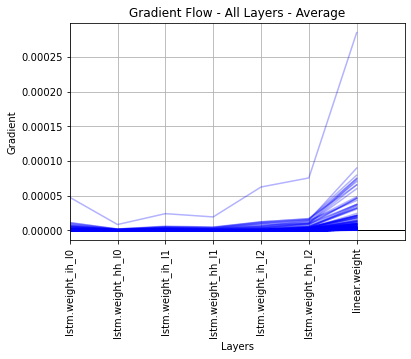

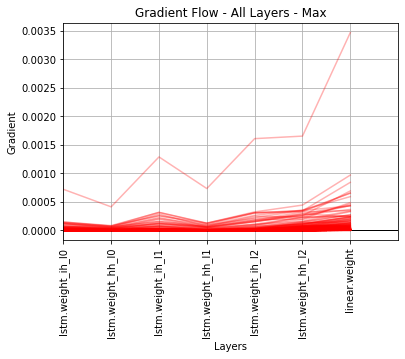

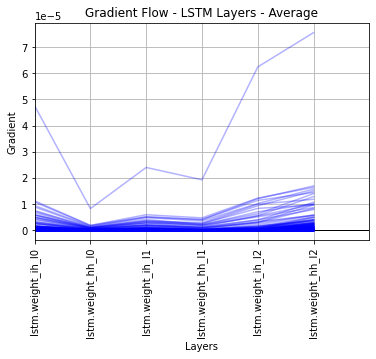

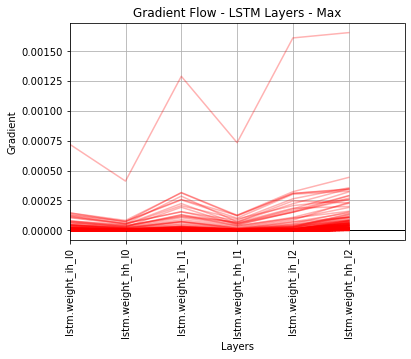

Number of gradients randomly sampled: 731
7
731
731
731


Training Time: 0:39:22.838338
N: 654 	MDA:51.99 	MAPE:-0.70 	MAE:0.00 	MSE:0.00
Num expected returns from training: 654
Initial Q:
 [1.14953580e-06 1.08725398e-05 2.03811195e-05 3.04114423e-05
 4.17265947e-05 5.84682206e-05 7.74168251e-05]
Unique bins: [0 1 2 3 4 5 6 7]
Counts / bin: [330  33  32  32  33  32  32 130]

Computing initial allocation policy from the training set...
77 -0.37 0.0001
Executed buy at $87.12 on day  77 bin 7
78 -0.37 -0.0014
Executed sell at $87.58 on day 78 Profit: $0.4669
79 -0.37 -0.0010
80 -0.37 0.0003
Executed buy at $87.17 on day  80 bin 7
81 -0.37 0.0015
82 -0.37 -0.0018
Executed sell at $88.10 on day 82 Profit: $0.9338
83 -0.37 0.0007
Executed buy at $87.66 on day  83 bin 7
84 -0.37 0.0008
85 -0.37 -0.0003
Executed sell at $87.64 on day 85 Profit: $-0.0146
86 -0.37 -0.0002
87 -0.37 0.0015
Executed buy at $87.90 on day  87 bin 7
88 -0.37 -0.0000
Executed sell at $87.69 on day 88 Profit: $-0.2042
89 -0.37 -0.0004
90 -0.37 0.0014
Executed buy at $88.17 on 

358 -0.35 0.0000
359 -0.35 0.0001
360 -0.35 0.0001
361 -0.35 -0.0000
Executed sell at $94.00 on day 361 Profit: $-1.0366
362 -0.35 -0.0000
363 -0.36 0.0001
Executed buy at $92.11 on day  363 bin 5
364 -0.36 0.0000
365 -0.35 0.0001
366 -0.35 0.0000
367 -0.35 -0.0001
Executed sell at $93.09 on day 367 Profit: $0.9769
368 -0.35 -0.0000
369 -0.35 0.0000
Executed buy at $94.12 on day  369 bin 3
370 -0.35 -0.0000
Executed sell at $94.45 on day 370 Profit: $0.3356
371 -0.35 0.0000
Executed buy at $94.58 on day  371 bin 4
372 -0.35 -0.0001
Executed sell at $94.49 on day 372 Profit: $-0.0895
373 -0.34 0.0001
Executed buy at $95.44 on day  373 bin 6
374 -0.34 -0.0000
Executed sell at $95.34 on day 374 Profit: $-0.0969
375 -0.35 0.0001
Executed buy at $94.87 on day  375 bin 5
376 -0.34 0.0000
377 -0.34 0.0000
378 -0.34 -0.0001
Executed sell at $95.60 on day 378 Profit: $0.7308
379 -0.34 -0.0001
380 -0.35 0.0001
Executed buy at $95.01 on day  380 bin 7
381 -0.35 -0.0000
Executed sell at $94.69 on 

Executed buy at $102.74 on day  3 bin 7
Executed sell at $102.60 on day 5 Profit: $-0.1381
Executed buy at $103.69 on day  8 bin 7
Executed sell at $103.66 on day 9 Profit: $-0.0230
Executed buy at $104.26 on day  11 bin 7
Executed sell at $106.03 on day 16 Profit: $1.7643
Executed buy at $102.41 on day  19 bin 7
Executed sell at $102.01 on day 20 Profit: $-0.3912
Executed buy at $100.53 on day  22 bin 7
Executed sell at $99.50 on day 23 Profit: $-1.0356
Executed buy at $100.76 on day  26 bin 7
Executed sell at $100.99 on day 27 Profit: $0.2225
Executed buy at $99.42 on day  28 bin 7
Executed sell at $99.97 on day 31 Profit: $0.5447
Executed buy at $103.85 on day  33 bin 7
Executed sell at $103.95 on day 34 Profit: $0.1002
Executed buy at $102.36 on day  36 bin 7
Executed sell at $105.64 on day 41 Profit: $3.2840
Executed buy at $105.53 on day  42 bin 7
Executed sell at $105.58 on day 43 Profit: $0.0540
Executed buy at $105.47 on day  44 bin 7
Executed sell at $102.47 on day 48 Profit:

Building LSTM Model with the following parameters:
Architecture: AH
Num layers: 3
Hidden size: 64
Dropout: 0.5
Learning Rate: 0.0001
LR Decay Rate: 1
Start training...
Iter	TrLoss		PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	2.22e-04 	0.057 	-0.003 	5.64e-05 	-0.377 	-0.381 	-0.374 	-0.013 	0.011
  1 	1.07e-04 	0.041 	0.011 	6.19e-06 	-0.374 	-0.372 	-0.374 	0.006 	-0.001
  2 	8.54e-05 	-0.004 	-0.001 	2.44e-07 	-0.374 	-0.373 	-0.374 	0.003 	0.001
  3 	4.15e-05 	0.029 	0.001 	4.13e-05 	-0.374 	-0.370 	-0.376 	0.012 	-0.007
  4 	2.52e-05 	-0.019 	-0.007 	7.45e-06 	-0.376 	-0.378 	-0.375 	-0.005 	0.004
  5 	4.06e-05 	-0.006 	0.004 	2.26e-06 	-0.375 	-0.374 	-0.372 	0.004 	0.009
  6 	1.63e-05 	-0.002 	0.009 	2.97e-06 	-0.372 	-0.374 	-0.373 	-0.006 	-0.001
  7 	1.43e-05 	-0.001 	-0.001 	1.87e-07 	-0.373 	-0.372 	-0.371 	0.002 	0.004
  8 	1.38e-05 	0.002 	0.004 	3.12e-06 	-0.371 	-0.373 	-0.371 	-0.005 	0.001
  9 	1.39e-05 	0.011 	0.001 	1.55e-06 	-0.371 	-0.373 	-0.374 	-0

103 	1.99e-08 	0.002 	0.003 	6.97e-06 	-0.373 	-0.373 	-0.371 	-0.000 	0.008
104 	1.65e-08 	0.008 	0.008 	7.55e-06 	-0.371 	-0.371 	-0.373 	-0.000 	-0.008
105 	4.32e-09 	-0.008 	-0.008 	1.91e-06 	-0.373 	-0.373 	-0.372 	-0.000 	0.004
106 	1.32e-08 	0.004 	0.004 	1.35e-05 	-0.372 	-0.372 	-0.368 	0.000 	0.011
107 	8.10e-09 	0.011 	0.011 	2.42e-06 	-0.368 	-0.368 	-0.367 	0.000 	0.005
108 	5.78e-09 	0.005 	0.005 	7.73e-07 	-0.367 	-0.367 	-0.366 	-0.000 	0.003
109 	1.32e-08 	0.003 	0.003 	1.82e-07 	-0.366 	-0.366 	-0.365 	0.000 	0.001
110 	8.49e-09 	0.001 	0.001 	1.47e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.004
111 	1.46e-08 	0.004 	0.004 	1.29e-09 	-0.364 	-0.364 	-0.364 	-0.000 	-0.001
112 	4.37e-09 	-0.001 	-0.001 	1.79e-06 	-0.364 	-0.364 	-0.365 	0.000 	-0.004
113 	9.24e-09 	-0.004 	-0.004 	2.96e-06 	-0.365 	-0.365 	-0.364 	0.000 	0.005
114 	7.72e-09 	0.005 	0.005 	1.28e-06 	-0.364 	-0.364 	-0.362 	0.000 	0.003
115 	5.54e-09 	0.003 	0.003 	3.65e-06 	-0.362 	-0.363 	-0.364 	-0.000 	-0.

209 	4.83e-09 	0.010 	0.010 	1.87e-07 	-0.352 	-0.352 	-0.352 	0.000 	0.001
210 	5.13e-09 	0.001 	0.001 	5.46e-07 	-0.352 	-0.352 	-0.352 	-0.000 	-0.002
211 	3.95e-09 	-0.002 	-0.002 	4.49e-07 	-0.352 	-0.352 	-0.352 	-0.000 	0.002
212 	3.16e-09 	0.002 	0.002 	4.44e-06 	-0.352 	-0.352 	-0.354 	0.000 	-0.006
213 	3.91e-09 	-0.006 	-0.006 	9.09e-08 	-0.354 	-0.354 	-0.354 	0.000 	-0.001
214 	3.14e-09 	-0.000 	-0.001 	7.58e-07 	-0.354 	-0.354 	-0.353 	0.000 	0.003
215 	4.97e-09 	0.003 	0.003 	1.07e-07 	-0.353 	-0.353 	-0.353 	0.000 	0.001
216 	5.67e-09 	0.001 	0.001 	5.36e-06 	-0.353 	-0.353 	-0.350 	0.000 	0.007
217 	2.48e-09 	0.007 	0.007 	2.11e-06 	-0.350 	-0.351 	-0.349 	-0.000 	0.004
218 	2.41e-09 	0.004 	0.004 	1.15e-06 	-0.349 	-0.349 	-0.350 	0.000 	-0.003
219 	3.80e-09 	-0.003 	-0.003 	1.45e-06 	-0.350 	-0.350 	-0.351 	0.000 	-0.003
220 	3.01e-09 	-0.003 	-0.003 	3.30e-06 	-0.351 	-0.351 	-0.353 	0.000 	-0.005
221 	3.68e-09 	-0.005 	-0.005 	9.06e-08 	-0.353 	-0.353 	-0.353 	0.00

315 	2.22e-09 	0.009 	0.009 	1.74e-07 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
316 	9.63e-10 	-0.001 	-0.001 	5.07e-07 	-0.333 	-0.333 	-0.333 	0.000 	0.002
317 	1.68e-09 	0.002 	0.002 	2.49e-08 	-0.333 	-0.333 	-0.333 	-0.000 	-0.001
318 	1.21e-09 	-0.000 	-0.001 	1.90e-05 	-0.333 	-0.333 	-0.337 	-0.000 	-0.012
319 	1.17e-09 	-0.012 	-0.012 	2.29e-05 	-0.337 	-0.337 	-0.342 	0.000 	-0.013
320 	8.60e-09 	-0.013 	-0.013 	5.07e-07 	-0.342 	-0.342 	-0.341 	0.000 	0.002
321 	1.03e-09 	0.002 	0.002 	2.82e-07 	-0.341 	-0.341 	-0.342 	0.000 	-0.001
322 	1.71e-09 	-0.001 	-0.001 	4.57e-05 	-0.342 	-0.342 	-0.348 	-0.000 	-0.019
323 	2.04e-09 	-0.019 	-0.019 	2.92e-06 	-0.348 	-0.349 	-0.350 	-0.000 	-0.005
324 	1.58e-09 	-0.005 	-0.005 	5.83e-06 	-0.350 	-0.350 	-0.348 	0.000 	0.007
325 	1.51e-09 	0.007 	0.007 	7.33e-06 	-0.348 	-0.348 	-0.350 	0.000 	-0.008
326 	7.98e-10 	-0.008 	-0.008 	7.15e-06 	-0.350 	-0.350 	-0.353 	0.000 	-0.008
327 	9.70e-10 	-0.008 	-0.008 	7.62e-06 	-0.353 	-0.353 	-

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [224]:
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.00001, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.0001, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.001, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)
model, journal, result = run_hypers(window_size=22, asset='SPY', train_epochs=1, iter_per_seq=500, arch='AH', num_layers=3, hidden_size=64, dropout=0.5, lr=0.01, dr=1, run_out_of_sample_test=0, verbosity=2, plot=1)

In [ ]:
# Everything past here is graveyard / experimental


Trial: 0
********

Building LSTM Model with the following parameters:
Architecture: LH
Num layers: 3
Hidden size: 128
Dropout: 0.5
Learning Rate: 0.01
LR Decay Rate: 1
Start training...
Epc	TrLoss		TAdjC	TPred	TAct	PredRt	ActRt	ValLoss		VAdjC	VPred	VAct	VPredRt	VActRt
  0 	3.21938e+00 	113.28 	111.67 	112.99 	-0.014 	-0.003 	1.64055e-01 	112.99 	111.75 	112.16 	-0.011 	-0.007
  1 	3.22708e+00 	113.28 	112.45 	112.99 	-0.007 	-0.003 	2.67082e-01 	112.99 	112.67 	112.16 	-0.003 	-0.007
  2 	1.63641e+00 	113.28 	113.90 	112.99 	0.006 	-0.003 	3.63475e+00 	112.99 	114.06 	112.16 	0.009 	-0.007
  3 	2.71235e+00 	113.28 	114.60 	112.99 	0.012 	-0.003 	6.07579e+00 	112.99 	114.62 	112.16 	0.014 	-0.007
  4 	4.52208e+00 	113.28 	114.76 	112.99 	0.013 	-0.003 	6.22808e+00 	112.99 	114.65 	112.16 	0.015 	-0.007
  5 	5.89842e+00 	113.28 	114.66 	112.99 	0.012 	-0.003 	5.30881e+00 	112.99 	114.46 	112.16 	0.013 	-0.007
  6 	6.69827e+00 	113.28 	114.51 	112.99 	0.011 	-0.003 	4.40221e+00 	112.99 	

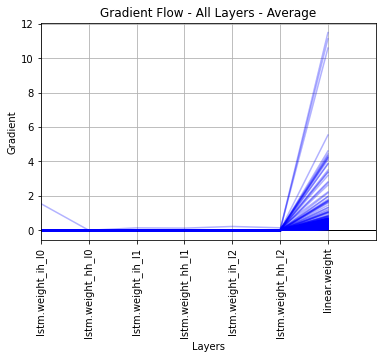

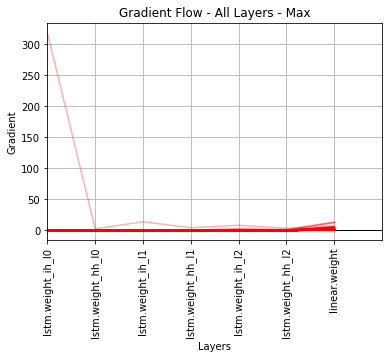

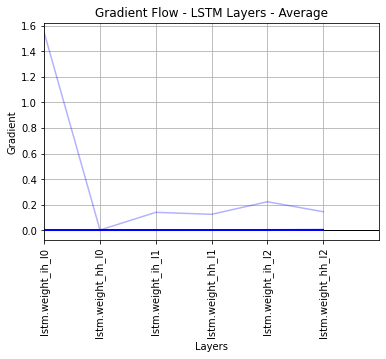

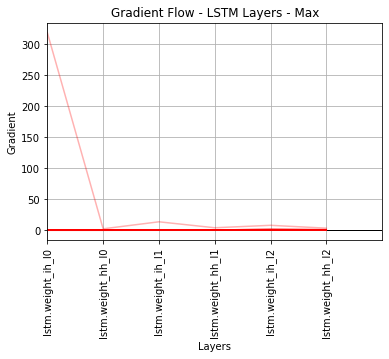

N: 654 	MDA:54.13 	MAPE:1.14 	MAE:1.17 	MSE:2.61
Num expected returns from training: 654
Initial Q:
 [1.44582819e-05 1.28522449e-03 2.51696439e-03 4.22260405e-03
 5.76507234e-03 7.82218298e-03 1.01230839e-02]

Computing initial allocation policy from the training set...
Expected Gains per Bin: [ 0.          4.72099304 11.08401489  7.41799927  7.74001312  7.06399536
 -5.19499969  5.16100311]
Trades per bin: [ 0. 14. 13.  8.  7.  9.  8.  5.]

Initial Allocation Policy: [0 1 1 1 1 1 0 1]

PERFORMING VALIDATION...
Buy and Hold Baseline:
Price at start: $137.36
Price at end: $112.52
Difference: $-24.84
Return:-18.08%

Profit from trading:-12.40
Return from trading:-9.03%
Length Returns: 1147
Q:
 [1.44582819e-05 2.02834734e-03 4.57916223e-03 6.81866138e-03
 1.04627632e-02 1.54055772e-02 2.21146239e-02]
E:
 [  0.           6.78299713  11.08401489 -17.43399811  11.67301178
  11.56499481  -5.19499969  17.07699966]
A:
 [0 1 1 0 1 1 0 1]
C:
 [0. 2. 0. 2. 2. 4. 0. 7.]
N: 493 	MDA:52.13 	MAPE:5.42 

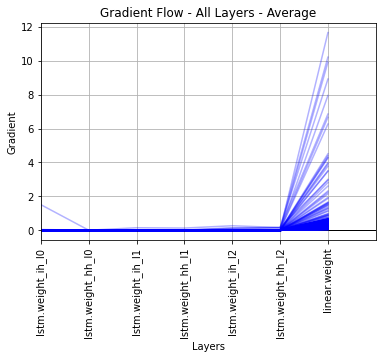

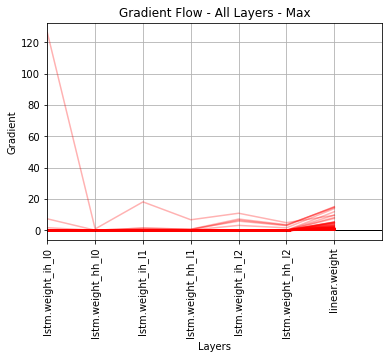

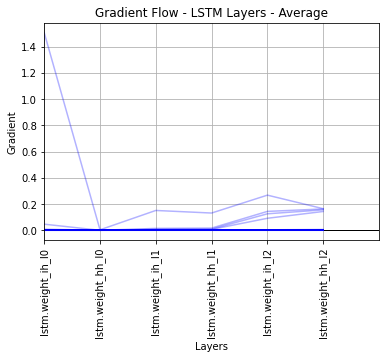

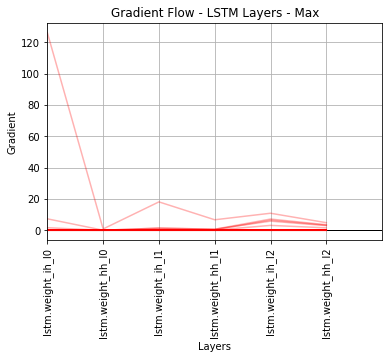

N: 654 	MDA:53.36 	MAPE:1.15 	MAE:1.17 	MSE:2.64
Num expected returns from training: 654
Initial Q:
 [8.19707115e-05 1.02753485e-03 2.79072820e-03 4.04947154e-03
 6.09088367e-03 7.54751173e-03 1.04135056e-02]

Computing initial allocation policy from the training set...
Expected Gains per Bin: [ 0.         10.31501007  6.3420105   9.47400665  2.25999451 -0.0289917
  2.17099762  3.97600555]
Trades per bin: [ 0. 18. 10. 12.  5.  6.  9.  4.]

Initial Allocation Policy: [0 1 1 1 1 0 1 1]

PERFORMING VALIDATION...
Buy and Hold Baseline:
Price at start: $137.36
Price at end: $112.52
Difference: $-24.84
Return:-18.08%

Profit from trading:3.61
Return from trading:2.63%
Length Returns: 1147
Q:
 [8.19707115e-05 2.18304230e-03 4.53257399e-03 7.12191152e-03
 1.06064021e-02 1.65000429e-02 2.31930081e-02]
E:
 [ 0.          9.90002441 12.32400513 21.37300873  2.25999451 -0.0289917
  9.87800598 -3.0249939 ]
A:
 [0 1 1 1 1 0 1 0]
C:
 [0. 3. 2. 3. 0. 0. 5. 4.]
N: 493 	MDA:53.14 	MAPE:5.32 	MAE:4.26 	MS

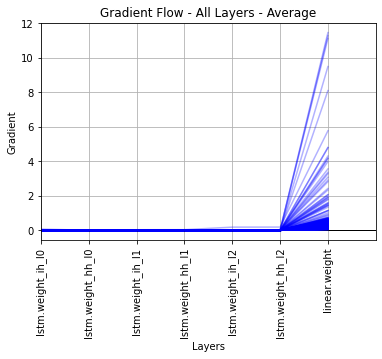

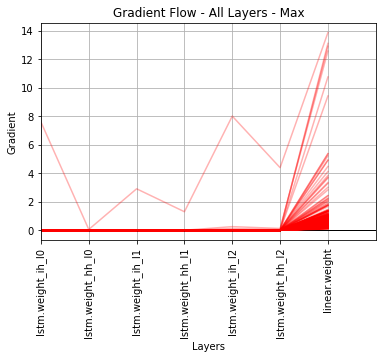

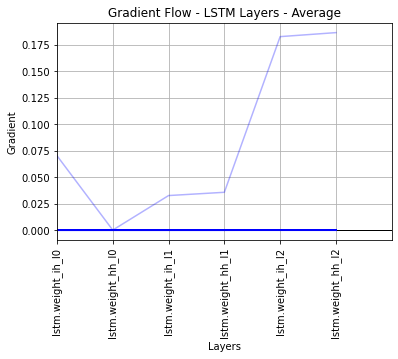

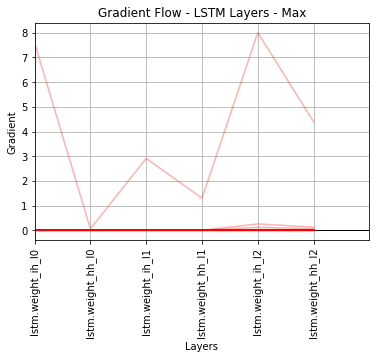

N: 654 	MDA:54.43 	MAPE:1.14 	MAE:1.16 	MSE:2.60
Num expected returns from training: 654
Initial Q:
 [5.82069250e-05 1.37477428e-03 2.60848845e-03 4.28708547e-03
 5.94447802e-03 7.73326859e-03 1.01884114e-02]

Computing initial allocation policy from the training set...
Expected Gains per Bin: [ 0.          6.47599792 14.51100159  8.06700134  2.36901093  9.5759964
 -7.07099915  5.93299866]
Trades per bin: [ 0. 12. 13.  9.  5. 11.  9.  5.]

Initial Allocation Policy: [0 1 1 1 1 1 0 1]

PERFORMING VALIDATION...
Buy and Hold Baseline:
Price at start: $137.36
Price at end: $112.52
Difference: $-24.84
Return:-18.08%

Profit from trading:-7.72
Return from trading:-5.62%
Length Returns: 1147
Q:
 [5.82069250e-05 1.87152309e-03 4.58126105e-03 7.66358342e-03
 1.10440840e-02 1.65718911e-02 2.49793041e-02]
E:
 [ 0.          9.66699982 -7.40499115  9.11000824  6.72400665 16.2539978
 -7.07099915 17.4859848 ]
A:
 [0 1 0 1 1 1 0 1]
C:
 [0. 3. 2. 1. 2. 4. 0. 8.]
N: 493 	MDA:51.52 	MAPE:5.80 	MAE:4.62 	

KeyboardInterrupt: 

In [302]:
test_results = []
val_results = []
for i in range(10):
    print("\nTrial:", i)
    print("********\n")
    model, journal, result = run_hypers(verbosity = 1, plot = 1)
    test_results.append(result['test_return_pct'])
    val_results.append(result['val_return_pct'])
    
print(np.mean(np.array(val_results)))
print(np.std(np.array(val_results)))

print(np.mean(np.array(test_results)))
print(np.std(np.array(test_results)))

In [ ]:
torch.set_printoptions(profile="short")

for name in model.named_parameters():
    print(name[0])
    print(name[1][:])

print(model.lstm.weight_ih_l0.size())
print(model.lstm.bias_ih_l0.size())
print(model.lstm.weight_hh_l0.size())
print(model.lstm.bias_hh_l0.size())


print(model.lstm.weight_hh_l1.size())
print(model.lstm.weight_ih_l1.size())

print(model.lstm.weight_hh_l2.size())
print(model.lstm.weight_ih_l2.size())

print(model.linear.weight.size())
print(model.linear.bias.size())





In [ ]:
# Use first asset in list of assets as the source
assets = ['SPY', 'DIA', 'ONEQ', 'IWM']

print(asset_list)
syn_df = asset_dict[asset_list[0]].copy()

display(syn_df.head(5))
print(syn_df.describe())    

asset_dict['SYN'] = syn_df 

trend_list = [(1, 20)]
make_synthetic_df(asset_dict['SYN'], trend_list, 0, 0, 1.4)

display(syn_df.head(5))
print(syn_df.describe())    


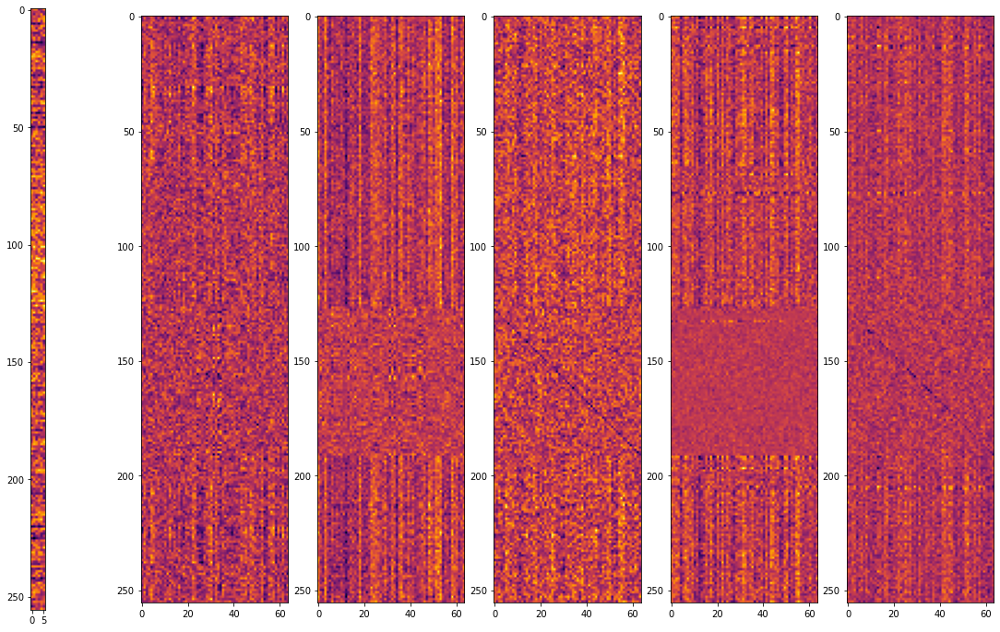

In [30]:
import matplotlib.pyplot as plt
import cv2

# norm_img=cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

# plt.imshow(img, cmap='gray')
fig, ax = plt.subplots(1,6,figsize=(20,12))
ax[0].imshow(model.lstm.weight_ih_l0.cpu().detach().numpy(), cmap='inferno')
ax[1].imshow(model.lstm.weight_hh_l0.cpu().detach().numpy(), cmap='inferno')
ax[2].imshow(model.lstm.weight_ih_l1.cpu().detach().numpy(), cmap='inferno')
ax[3].imshow(model.lstm.weight_hh_l1.cpu().detach().numpy(), cmap='inferno')
ax[4].imshow(model.lstm.weight_ih_l2.cpu().detach().numpy(), cmap='inferno')
ax[5].imshow(model.lstm.weight_hh_l2.cpu().detach().numpy(), cmap='inferno')

# ih_l0 - has dimension 6 x 512

# fig.tight_layout()

In [ ]:
# Stock market indices
# assets = ['^GSPC', '^DJI', '^IXIC', '^RUT']

assets = ['SPY', 'DIA', 'ONEQ', 'IWM']

asset_list = assets

In [ ]:
# Iterate through index list, check if we already have the data (load it) or go get it from Yahoo! (save it)
# Make a dictionary of dataframes containing all the data

start_date = '01-01-2005'
# stop_date = '05-01-2018' # First version of paper
stop_date = '12-20-2019' # Final version of paper
directory = '../../../data/yahoo_data'

# If the 'directory' doesn't exist, create it
#if os.path.isdir(directory) == False:
#    os.mkdir(directory)

asset_dict = {}
for asset in asset_list:
    df = get_data(asset_name=asset, directory=directory, start_date=start_date, stop_date=stop_date)    
    asset_dict[asset] = df 

In [ ]:
for asset in asset_list:
    display(asset_dict[asset].head(5))
    print(asset, asset_dict[asset].describe())

In [ ]:
# Plot all the assets in Plotly interactive charts with a Candlestick chart
for asset in asset_list:
    plotly_candlestick(asset_dict, asset)

In [ ]:
# Before we split the data into train, validation and test sets let's add the Prev Adj Close feature and
# remove the Date and Volume columns (which are not used)

for asset in asset_list:
    asset_dict[asset] = add_features_to_df(asset_dict[asset])       
    display(asset, asset_dict[asset].head(5))

In [ ]:
# Define the start and end dates for each of the sets - start and end dates are inclusive

# Training set
train_start = '01-01-2005'
train_end = '01-01-2008'

# Validation set
valid_start = '01-02-2008'
valid_end = '12-31-2009'

# A combined train / valid set
train_val_start = '01-01-2005'
train_val_end = '12-31-2009'

# Pre-test set (120 days prior to test period, to generate allocation policy for testing)
pre_test_start = '07-15-2009'
pre_test_end = '12-31-2009'

# Out of sample test set
test_start = '01-01-2010'
test_end = '12-20-2019'


In [21]:
# paper_baseline = {'SPY':136.4, 'DIA':136.6, 'ONEQ':228.9, 'IWM':163.5} # Original paper
paper_baseline = {'SPY':188.87, 'DIA':172.87, 'ONEQ':293.32, 'IWM':167.34, 'SYN':0} # Latest paper - table 12


train_asset_dict = {}
valid_asset_dict = {}
test_asset_dict = {}
train_val_asset_dict = {}
pre_test_asset_dict = {}

for asset in asset_list:
    # Make a dataframe for this asset
    df = asset_dict[asset]
    
    # Mask off the training data and assign result to a train_asset dictionary
    mask = (df['Date'] >= train_start) & (df['Date'] <= train_end)
    train_asset_dict[asset] = df.loc[mask]
    
    # Mask off the validation data and assign result to a valid_asset dictionary
    mask = (df['Date'] >= valid_start) & (df['Date'] <= valid_end)
    valid_asset_dict[asset] = df.loc[mask]
    
    # Mask off the test data and assign result to a test_asset dictionary
    mask = (df['Date'] >= test_start) & (df['Date'] <= test_end)
    test_asset_dict[asset] = df.loc[mask]
    
    # Mask off the combined train / validation data and assign result to a train_val_asset dictionary
    mask = (df['Date'] >= train_val_start) & (df['Date'] <= train_val_end)
    train_val_asset_dict[asset] = df.loc[mask]

    # Mask off the pre_test data and assign result to a pre_test_asset dictionary
    mask = (df['Date'] >= pre_test_start) & (df['Date'] <= pre_test_end)
    pre_test_asset_dict[asset] = df.loc[mask]
    
    # Reset the indices to start from 0 again for each of the dataframes
    train_asset_dict[asset].index = np.arange(train_asset_dict[asset].shape[0])    
    valid_asset_dict[asset].index = np.arange(valid_asset_dict[asset].shape[0])    
    test_asset_dict[asset].index = np.arange(test_asset_dict[asset].shape[0])
    train_val_asset_dict[asset].index = np.arange(train_val_asset_dict[asset].shape[0])    
    pre_test_asset_dict[asset].index = np.arange(pre_test_asset_dict[asset].shape[0])    

    
#    display(test_asset_dict[asset])

print("Adjusted Close to Adjusted Close:")
print('Asset\tStart Date\t\tBeg$\tEnd Date\t\tEnd$\tGain%\tPaper%')
for asset in asset_list:
    # Print the buy and hold returns over the entire test period (the papers baseline)
    start = test_asset_dict[asset]['Adj Close'].loc[0]
    end = test_asset_dict[asset]['Adj Close'].loc[test_asset_dict[asset].shape[0]-1]
    gain = 100.0 * (end - start) / start
    
    print(asset, '\t', test_asset_dict[asset]['Date'].loc[0], '\t{:1.2f}'.format(start), '\t', 
          test_asset_dict[asset]['Date'].loc[test_asset_dict[asset].shape[0]-1], 
          '\t{:1.2f}'.format(end), '\t{:1.2f}'.format(gain), '\t{:1.2f}'.format(paper_baseline[asset]))

print("\nClose to Close:")
print('Asset\tStart Date\t\tBeg$\tEnd Date\t\tEnd$\tGain%\tPaper%')
for asset in asset_list:
    # Print the buy and hold returns over the entire test period (the papers baseline)
    start = test_asset_dict[asset]['Close'].loc[0]
    end = test_asset_dict[asset]['Close'].loc[test_asset_dict[asset].shape[0]-1]
    gain = 100.0 * (end - start) / start
    
    print(asset, '\t', test_asset_dict[asset]['Date'].loc[0], '\t{:1.2f}'.format(start), '\t', 
          test_asset_dict[asset]['Date'].loc[test_asset_dict[asset].shape[0]-1], 
          '\t{:1.2f}'.format(end), '\t{:1.2f}'.format(gain), '\t{:1.2f}'.format(paper_baseline[asset]))
    
print("\nOpen to Close:")
print('Asset\tStart Date\t\tBeg$\tEnd Date\t\tEnd$\tGain%\tPaper%')
for asset in asset_list:
    # Print the buy and hold returns over the entire test period (the papers baseline)
    start = test_asset_dict[asset]['Open'].loc[0]
    end = test_asset_dict[asset]['Close'].loc[test_asset_dict[asset].shape[0]-1]
    gain = 100.0 * (end - start) / start
    
    print(asset, '\t', test_asset_dict[asset]['Date'].loc[0], '\t{:1.2f}'.format(start), '\t', 
          test_asset_dict[asset]['Date'].loc[test_asset_dict[asset].shape[0]-1], 
          '\t{:1.2f}'.format(end), '\t{:1.2f}'.format(gain), '\t{:1.2f}'.format(paper_baseline[asset]))    
    
# It looks like the paper used Close-Close or Open-Close rather than Adjusted Close to compute gains over the test period. 
# They are a lot closer to the paper quoted returns and better correlated
    

In [ ]:
print("Train set length:", len(train_asset_dict['SPY']))
print("Valid set length", len(valid_asset_dict['SPY']))
print("Train / Valid set length", len(train_val_asset_dict['SPY']))
print("Pre-test set", len(pre_test_asset_dict['SPY']))
print("Test set",len(test_asset_dict['SPY']))